## Processing Ocean Color Imagery

This data was collected in a mapping fashion with a constant viewing geometry of 40 and 135

In [1]:
%load_ext autoreload
%autoreload 2

In [63]:
import geopandas as gpd
import pandas as pd


import os, glob
import multiprocessing
import math

#import cv2
import numpy as np
import matplotlib.pyplot as plt

#import exiftool
import datetime

import rasterio

from utils import *
from georeg import *

In [3]:
data_dir = os.path.join('data', '20210427_gulf_stream_surveys', 'flight1')
data_dir

'data/20210427_gulf_stream_surveys/flight1'

In [4]:
#grab last 4 characters of the file name:
def last_10chars(x):
    return(x[-10:])

img_fns = glob.glob(data_dir + '/sea' + "/*.tif")

img_fns = sorted(img_fns, key = last_10chars)
len(img_fns)

2700

In [11]:
! ls data/20210427_gulf_stream_surveys/flight1

all_imgs  chla	panel  rededge	sea  sky  SYNLog-13-06-13_27-04-2021.csv


In [12]:
data_dir

'data/20210427_gulf_stream_surveys/flight1'

In [14]:
alta_logs = format_alta_logs(data_dir + '/SYNLog-13-06-13_27-04-2021_edit.csv')
alta_logs.head()

/home/clifgray/anaconda3/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3347: DtypeWarning: Columns (0,1,2,4,5,6,7,9) have mixed types.Specify dtype option on import or set low_memory=False.
  if (await self.run_code(code, result,  async_=asy)):


,Reading,IMU Time,Date,GPS Time,Unnamed: 4,Longitude,Latitude,GPS Height,GPS Course,GPS Pos N,...,Gyro Bias P,Gyro Bias Y,Accel Bias X,Accel Bias Y,Accel Bias Z,Extended Status,5V Alarm,Z Vibration,Checksum,id
dt,,,,,,,,,,,,,,,,,,,,,
2021-04-27 13:06:13.000000,49,1.904,20210427,13:06:13,NaN,-762791232,340387040,1.69,6.8,33.41,...,-39.3409,7.5146,0.058,0.045,0.281,0.0,0.0,0.07,66.0,0
2021-04-27 13:06:13.000001,50,1.944,20210427,13:06:13,NaN,-762791232,340387040,1.69,6.8,33.41,...,-39.3467,7.5144,0.058,0.045,0.280,0.0,0.0,0.07,149.0,1
2021-04-27 13:06:13.000002,51,1.984,20210427,13:06:13,NaN,-762791232,340387040,1.69,6.8,33.41,...,-39.3376,7.5147,0.058,0.046,0.281,0.0,0.0,0.08,16.0,2
2021-04-27 13:06:13.000003,52,2.024,20210427,13:06:13,NaN,-762791232,340387040,1.69,6.8,33.41,...,-39.3390,7.5146,0.058,0.046,0.281,0.0,0.0,0.08,169.0,3
2021-04-27 13:06:13.000004,53,2.064,20210427,13:06:13,NaN,-762791232,340387040,1.69,6.8,33.41,...,-39.3459,7.5102,0.058,0.047,0.281,0.0,0.0,0.08,145.0,4


In [15]:
sky_dir = os.path.join(data_dir, 'sky', 'stacks')
surface_dir = os.path.join(data_dir, 'sea', 'stacks')

In [9]:
280-330

-50

In [32]:
start = 95
count = 60
sea_imgs, sea_img_metadata = retrieve_imgs_and_metadata(surface_dir, count=count, start=start, altitude_cutoff=0)

/home/clifgray/anaconda3/lib/python3.8/site-packages/rasterio/__init__.py:207: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


Find the closest row in the flight logs based on time stamp and add the more accurate yaw

In [40]:
for item in sea_img_metadata:
    utc_time = datetime.datetime.strptime('2021-04-27-' + item['UTC-Time'], '%Y-%m-%d-%H:%M:%S')
    img_idx = alta_logs.index.get_loc(utc_time, method='nearest')
    item['log_id'] = img_idx
    item['alta_yaw'] = (alta_logs.iloc[img_idx]['Yaw'] + 360) % 360
    # then ensures
    item['image_name'] = img_fns[start*6+item['id']*6]

In [12]:
sky_imgs, sky_img_metadata = retrieve_imgs_and_metadata(sky_dir, count=15, start=40, altitude_cutoff=0)

In [13]:
retrieve_imgs_and_metadata(sky_dir, count=1, start=40, altitude_cutoff=0)[0][0].shape

(6, 1470, 2024)

In [33]:
blocked_dir = os.path.join(data_dir, 'rededge', 'tube', 'stacks')
blocked_dir

'data/20210427_gulf_stream_surveys/flight1/rededge/tube/stacks'

In [34]:
blocked_imgs, blocked_img_metadata = retrieve_imgs_and_metadata(blocked_dir, count=20, start=0, altitude_cutoff=0)

In [13]:
sky_dir_re = os.path.join('data', '20210407_duml_full_workflow_test', 'sky_rededge', 'stacks')
surface_dir_re = os.path.join('data', '20210407_duml_full_workflow_test', 'sea_rededge', 'stacks')

In [14]:
sky_re_imgs, sky_re_img_metadata = retrieve_imgs_and_metadata(sky_dir_re, count=100, start=0, altitude_cutoff=0)
sea_re_imgs, sea_re_img_metadata = retrieve_imgs_and_metadata(surface_dir_re, count=100, start=0, altitude_cutoff=0)

Output shape is:  (4, 5, 946, 1267)
Output shape is:  (9, 5, 946, 1267)


only grab metadata

Open the md of each image and then sort by time and then I know the order of pitch

then I can sort by pitch and yaw

In [35]:
band_names = ['blue', 'green', 'red', 'red edge', 'nir']

In [17]:
mds = load_img_fn_and_meta(surface_dir, start=0)
len(mds)

449

In [14]:
for md in mds:
    if md['filename'] == '378vNa6UAi8CshsGKO4m.tif':
        print(md['UTC-Time'])

14:55:37


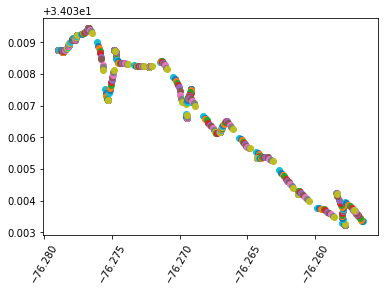

In [18]:
for md in mds:
    plt.scatter(md['Longitude'],md['Latitude'])
    plt.xticks(rotation=60)

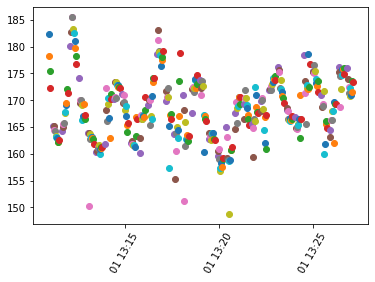

In [30]:
for md in mds[95:]:
    plt.scatter(datetime.datetime.strptime(md['UTC-Time'], '%H:%M:%S'), md['yaw'])
    plt.xticks(rotation=60)

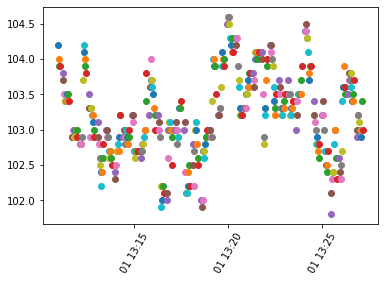

In [31]:
for md in mds[95:]:
    plt.scatter(datetime.datetime.strptime(md['UTC-Time'], '%H:%M:%S'), md['Altitude'])
    plt.xticks(rotation=60)

In [38]:
from datetime import datetime
chla_dates = []
for im in sea_img_metadata:
    date_time_str = im['Date'] + ' ' + im['UTC-Time']

    date_time_obj = datetime.strptime(date_time_str, '%m/%d/%Y %H:%M:%S')
    chla_dates.append(date_time_obj)

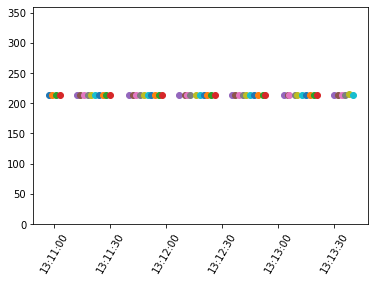

In [42]:
import datetime

for md in sea_img_metadata:
    plt.scatter(datetime.datetime.strptime(md['UTC-Time'], '%H:%M:%S'), md['alta_yaw'])
    plt.xticks(rotation=60)
    plt.ylim(0,360)

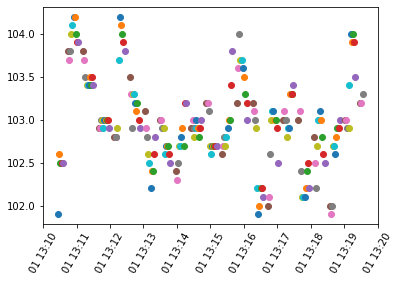

In [24]:
import datetime

for md in mds[84:]:
    plt.scatter(datetime.datetime.strptime(md['UTC-Time'], '%H:%M:%S'), md['Altitude'])
    plt.xticks(rotation=60)

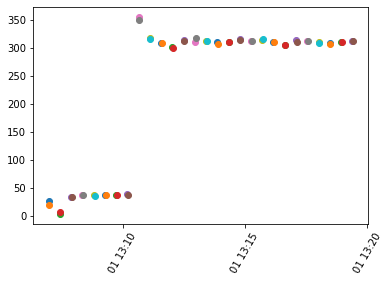

In [13]:
for md in mds:
    plt.scatter(datetime.datetime.strptime(md['UTC-Time'], '%H:%M:%S'), md['pitch'])
    plt.xticks(rotation=60)

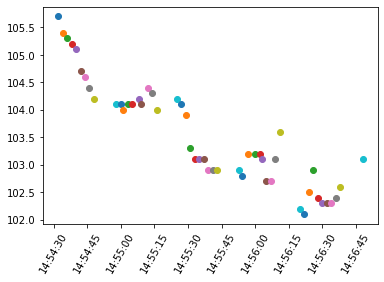

In [42]:
for md in sea_img_metadata:
    plt.scatter(datetime.datetime.strptime(md['UTC-Time'], '%H:%M:%S'), md['Altitude'])
    plt.xticks(rotation=60)

In [17]:
sea_imgs.nbytes / 1e9

8.5561056

In [18]:
sky_imgs.nbytes / 1e9

2.1422016

Inspect a couple images

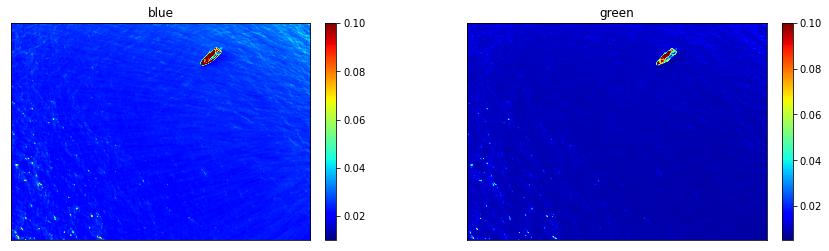

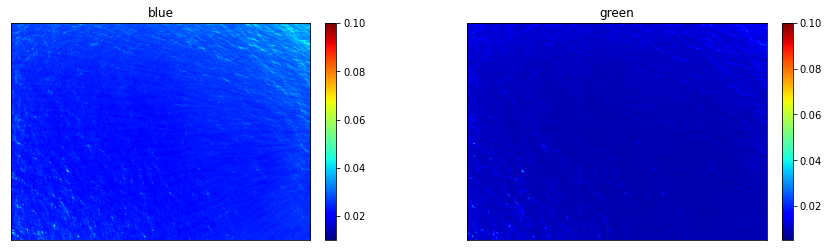

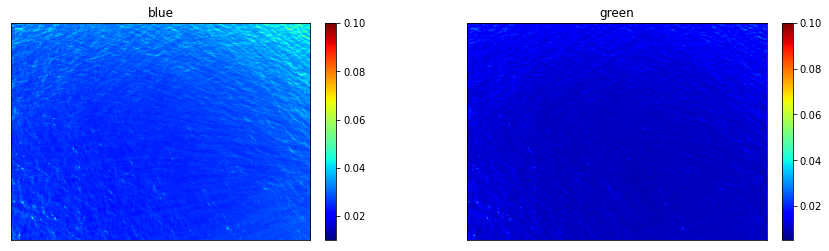

In [44]:
for i in [10,25,45]:
    fig, ax = plt.subplots(1,2, figsize=(15,4))
    im = ax[0].imshow(sea_imgs[i,0],cmap='jet', vmin=0.01, vmax=.1)
    fig.colorbar(im, ax=ax[0], fraction=0.046, pad=0.04)
    ax[0].set_xticks([])
    ax[0].set_yticks([])
    ax[0].set_title('blue')
    
    im = ax[1].imshow(sea_imgs[i,1],cmap='jet', vmin=0.005, vmax=.1)
    fig.colorbar(im, ax=ax[1], fraction=0.046, pad=0.04)
    ax[1].set_xticks([])
    ax[1].set_yticks([])
    ax[1].set_title('green')
    plt.show()

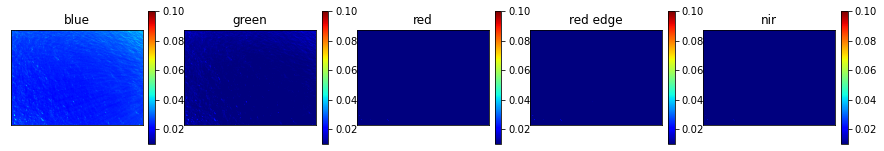

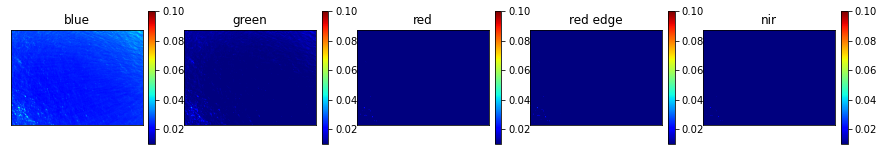

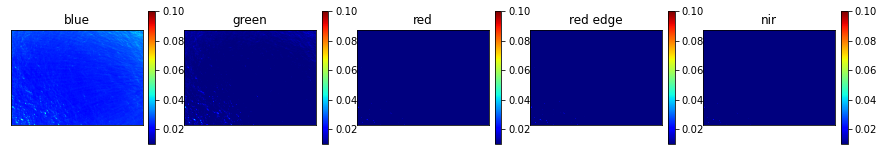

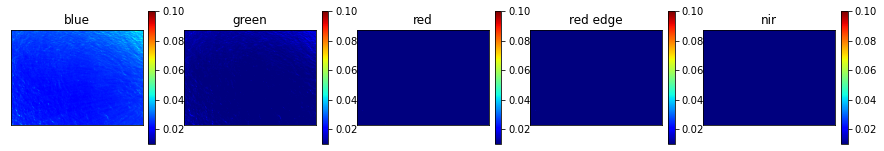

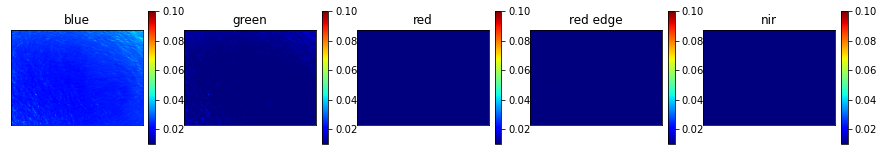

In [45]:
for j in range(21,26):
    fig, ax = plt.subplots(1,5, figsize=(15,4))
    for i in range(5):
        im = ax[i].imshow(sea_imgs[j,i],cmap='jet', vmin=0.01, vmax=.1)
        fig.colorbar(im, ax=ax[i], fraction=0.046, pad=0.04)
        ax[i].set_xticks([])
        ax[i].set_yticks([])
        ax[i].set_title(band_names[i])

Visualize some stacked RGB images

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


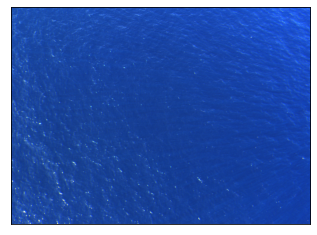

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


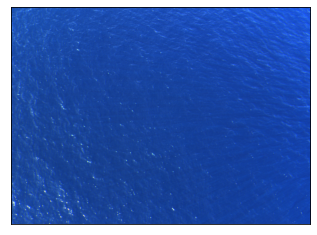

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


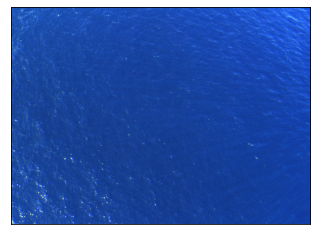

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


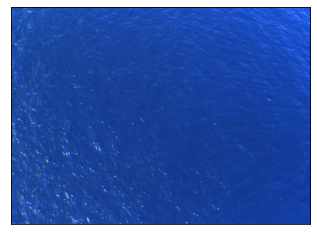

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


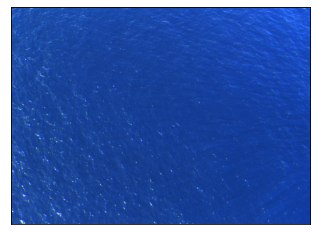

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


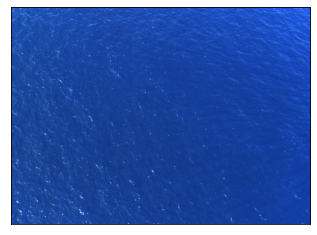

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


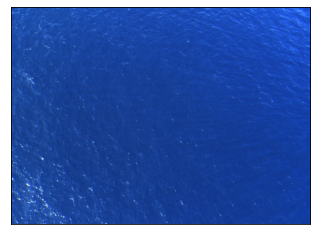

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


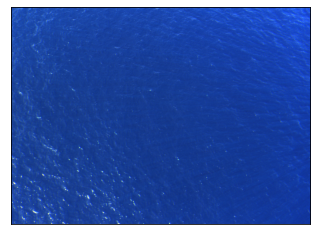

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


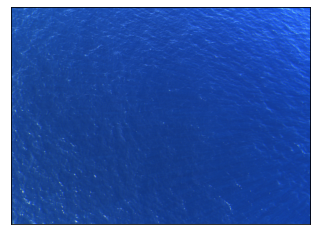

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


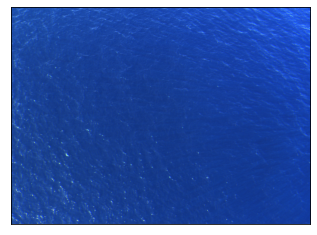

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


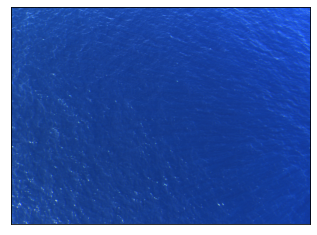

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


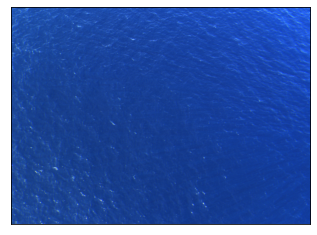

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


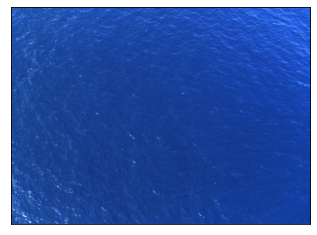

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


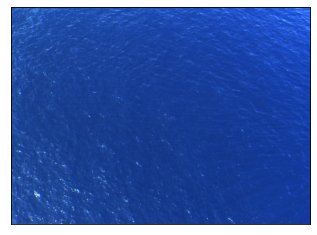

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


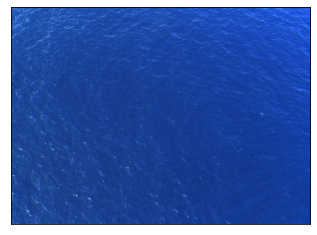

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


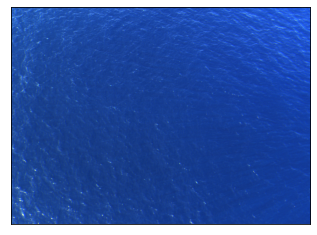

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


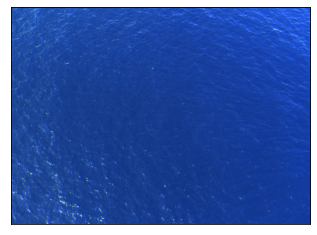

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


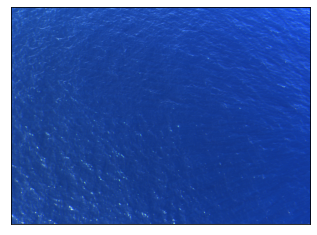

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


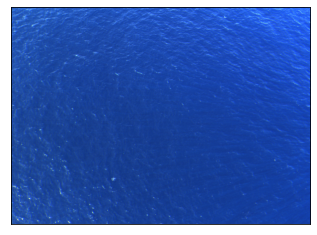

In [49]:
for j in range(16,35):
    plt.imshow((np.transpose(sea_imgs[j,0:3]/0.04, (1,2,0))[:,:,::-1]))
    plt.xticks([])
    plt.yticks([])
    plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


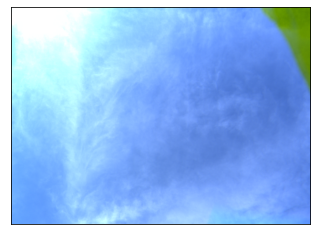

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


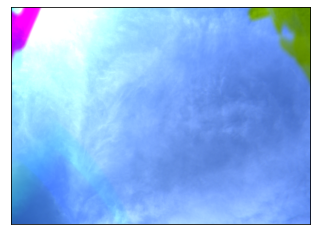

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


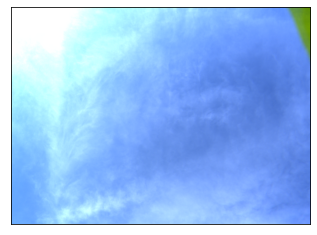

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


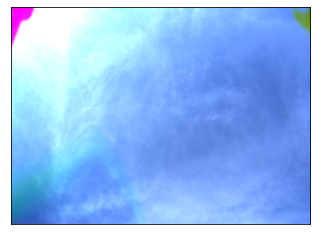

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


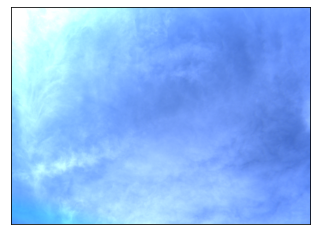

In [23]:
for j in range(0,5):
    plt.imshow((np.transpose(sky_imgs[j,0:3]/0.3, (1,2,0))[:,:,::-1]))
    plt.xticks([])
    plt.yticks([])
    plt.show()

### create medians of each image for correction

In [47]:
sea_imgs.shape

(60, 6, 1470, 2024)

In [50]:
sea_median = np.median(sea_imgs[16:35], axis=0)

In [23]:
sky_median = np.median(sky_imgs[0:10], axis=0)

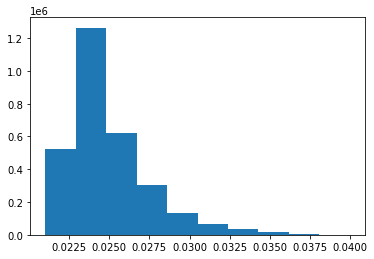

In [55]:
plt.hist(sea_median[0].flatten())
plt.show()

In [69]:
np.median(sea_median, axis=(1,2))

array([0.02423096, 0.01016235, 0.00378418, 0.00320435, 0.00247192,
       0.89453125])

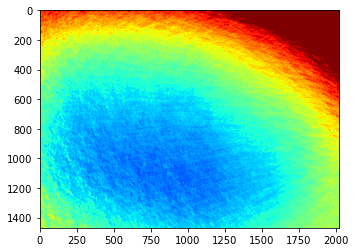

In [56]:
plt.imshow(sea_median[0], vmin=0.02,vmax=.03, cmap='jet')

In [52]:
plt.imshow(sky_median[0], vmin=0.04,vmax=.55, cmap='jet')

NameError: name 'sky_median' is not defined

#### inspect the sun blocked spectra based on the brightest pics there

In [57]:
blocked_imgs.shape

(19, 5, 946, 1248)

brightest pixels used: 1180
brightest pixels used: 1180
brightest pixels used: 1180
brightest pixels used: 1180
brightest pixels used: 1180
brightest pixels used: 1180
brightest pixels used: 1180
brightest pixels used: 1180
brightest pixels used: 1180
brightest pixels used: 1180
brightest pixels used: 1180
brightest pixels used: 1180
brightest pixels used: 1180
brightest pixels used: 1180
brightest pixels used: 1180
brightest pixels used: 1180
brightest pixels used: 1180
brightest pixels used: 1180
brightest pixels used: 1180


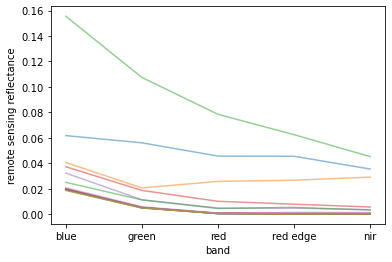

In [70]:
blocked_spectra = []
for i in range(0,blocked_imgs.shape[0]):
    spec = brightest_tube_pix(blocked_imgs[i], percent=0.001)
    plt.plot(band_names, spec, alpha=0.5)
    plt.ylabel('remote sensing reflectance')
    plt.xlabel('band')
    blocked_spectra.append(spec)
blocked_spectra = np.array(blocked_spectra)

In [28]:
0.03035012 / 0.00595001

5.100851931341292

In [61]:
0.020176/0.00536137

3.7632172373852204

In [71]:
median_blocked_spec = np.median(blocked_spectra,axis=0)
median_blocked_spec

array([0.01986806, 0.00526635, 0.00052283, 0.00026186, 0.00020649])

In [72]:
median_blocked_spec[0]/median_blocked_spec[1]

3.772641555762903

In [64]:
ci1 = -0.49
ci2 = 191.6590

# ci1 = -0.38152295986028695
# ci2 = 271.37634868

# average of 443*.5 + 489*1.5
# ci1 = -0.30002281538304754
# ci2 = 310.5772338

# ci1 = -0.21380600002416383
# ci2 = 572.01573044



def oc_index(blue, green, red):
    blue, green, red = blue/math.pi, green/math.pi, red/math.pi
    CI = green - ( blue + (555 - 477)/(667 - 477) * (red - blue) )
    
    #print(green)
    #print(( blue + (555 - 443)/(667 - 443) * (red - blue) ))
    
    #print(CI)

    ChlCI = 10**(ci1 + ci2*CI)
    return(ChlCI)

In [67]:
oc_index(0.03035012, 0.00595001, 0.00065926)

0.058214344117051633

In [68]:
print('chla is: ', oc_index(median_blocked_spec[0],median_blocked_spec[1], median_blocked_spec[2]))

chla is:  0.12519275358353624


Run through each image, subtract the blocked spectra, then find the average spectra, then run chla algorithm on it, then add it to list

### Correct for sun glint

### This is the current approach to calculating rho based on sunblocked spectra

Simple version

Take the blocked spectra and subtract that from Lt and then smooth that over and that is the correction to all the other images

Sea median - blocked_spectra is lsky * rho. So then to get Lw in the future all I need to do is subtract that from Lt

In [73]:
smoothed_lt_lw = ndimage.gaussian_filter(((sea_median[:5,:,:].T - np.median(blocked_spectra, axis=0)).T), sigma=(0, 10, 10), order=0)

Visualize the sea median bands

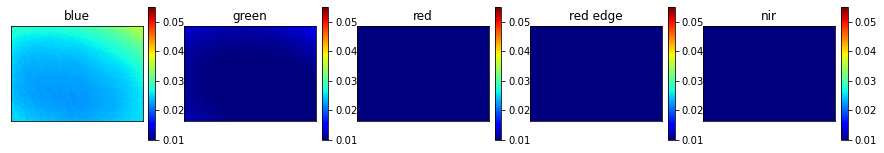

In [74]:
fig, ax = plt.subplots(1,5, figsize=(15,4))
for i in range(5):
    im = ax[i].imshow(sea_median[i],cmap='jet', vmin=0.01, vmax=.055)
    fig.colorbar(im, ax=ax[i], fraction=0.046, pad=0.04)
    ax[i].set_xticks([])
    ax[i].set_yticks([])
    ax[i].set_title(band_names[i])

Sea median images divided by image mean

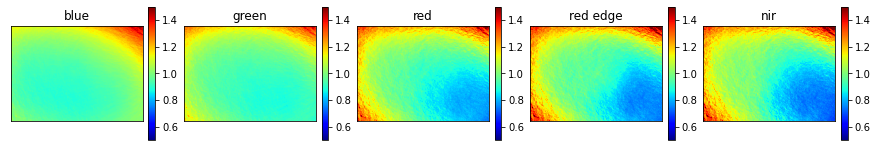

In [75]:
fig, ax = plt.subplots(1,5, figsize=(15,4))
for i in range(5):
    im = ax[i].imshow(sea_median[i]/np.mean(sea_median[i]),cmap='jet', vmin=0.5, vmax=1.5)
    fig.colorbar(im, ax=ax[i], fraction=0.046, pad=0.04)
    ax[i].set_xticks([])
    ax[i].set_yticks([])
    ax[i].set_title(band_names[i])

Sky median images

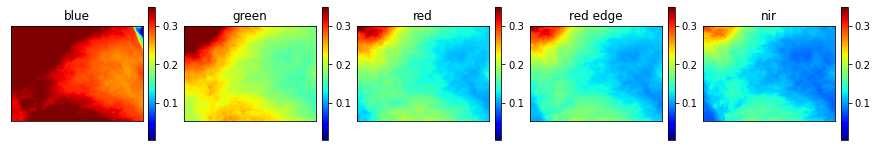

In [89]:
fig, ax = plt.subplots(1,5, figsize=(15,4))
for i in range(5):
    im = ax[i].imshow(sky_median[i],cmap='jet', vmin=0.003, vmax=.35)
    fig.colorbar(im, ax=ax[i], fraction=0.046, pad=0.04)
    ax[i].set_xticks([])
    ax[i].set_yticks([])
    ax[i].set_title(band_names[i])

Sky median divided by the mean sky median

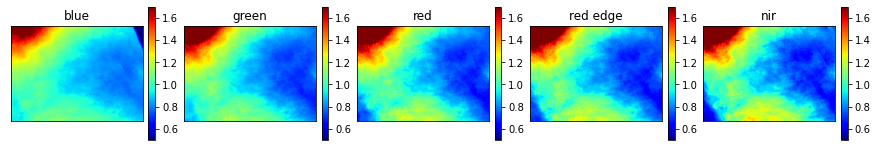

In [90]:
fig, ax = plt.subplots(1,5, figsize=(15,4))
for i in range(5):
    im = ax[i].imshow(sky_median[i]/np.mean(sky_median[i]),cmap='jet', vmin=.5, vmax=1.7)
    fig.colorbar(im, ax=ax[i], fraction=0.046, pad=0.04)
    ax[i].set_xticks([])
    ax[i].set_yticks([])
    ax[i].set_title(band_names[i])

Smoothed lt - lw images (aka rho*lsky)

***This is what will be subtracted from each image

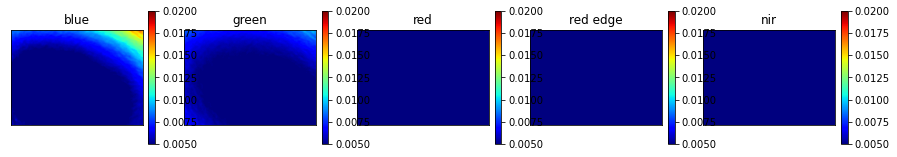

In [79]:
fig, ax = plt.subplots(1,5, figsize=(15,4))
for i in range(5):
    im = ax[i].imshow(smoothed_lt_lw[i],cmap='jet', vmin=0.005, vmax=.02)
    fig.colorbar(im, ax=ax[i], fraction=0.046, pad=0.04)
    ax[i].set_xticks([])
    ax[i].set_yticks([])
    ax[i].set_title(band_names[i])

lt - lw divided buy the mean of that

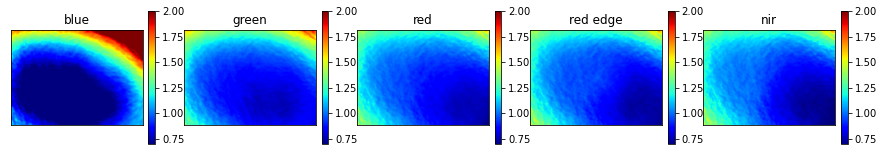

In [80]:
fig, ax = plt.subplots(1,5, figsize=(15,4))
for i in range(5):
    im = ax[i].imshow(smoothed_lt_lw[i]/np.mean(smoothed_lt_lw[i]),cmap='jet', vmin=.7, vmax=2)
    fig.colorbar(im, ax=ax[i], fraction=0.046, pad=0.04)
    ax[i].set_xticks([])
    ax[i].set_yticks([])
    ax[i].set_title(band_names[i])

lt-lw divided by lsky which is effectively rho

NameError: name 'sky_median' is not defined

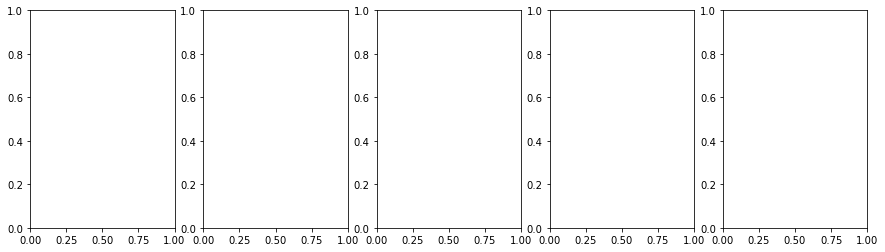

In [81]:
fig, ax = plt.subplots(1,5, figsize=(15,4))
for i in range(5):
    im = ax[i].imshow(smoothed_lt_lw[i]/sky_median[i,::-1,:2021],cmap='jet', vmin=0.001, vmax=.2)
    fig.colorbar(im, ax=ax[i], fraction=0.046, pad=0.04)
    ax[i].set_xticks([])
    ax[i].set_yticks([])
    ax[i].set_title(band_names[i])

### Apply simple approach

just take smoothed_lt_lw and subtract it from the lt images

First look at all bands

/home/clifgray/Code/ocean_color/utils.py:422: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(1,5, figsize=(16,14))


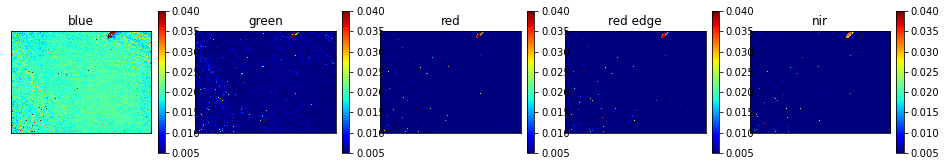

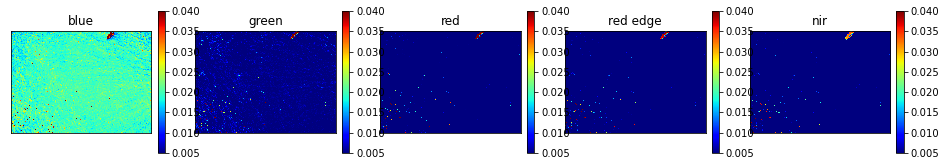

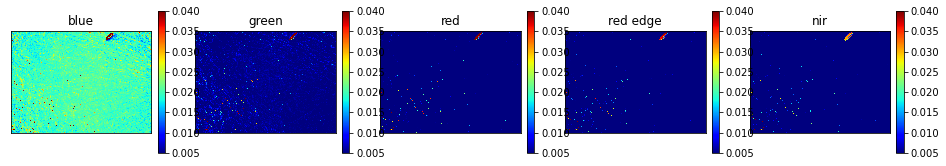

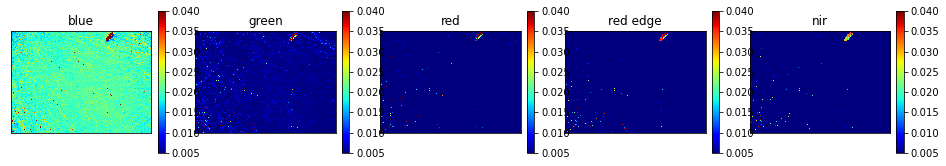

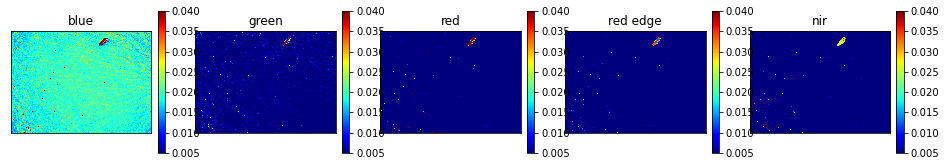

...

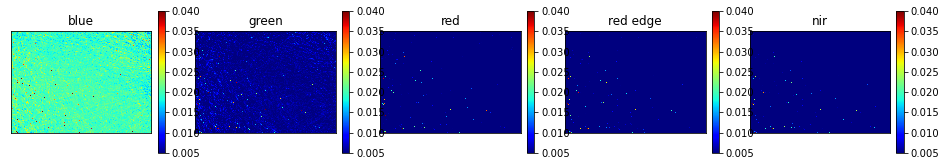

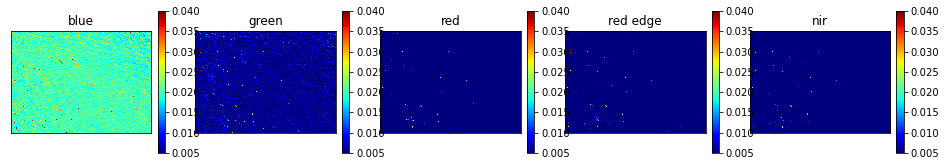

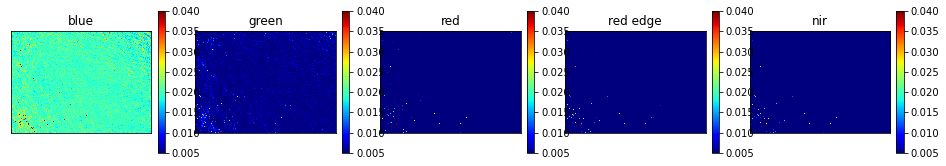

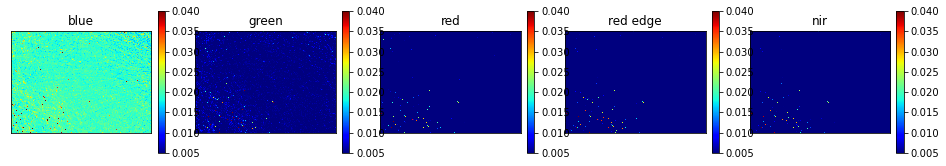

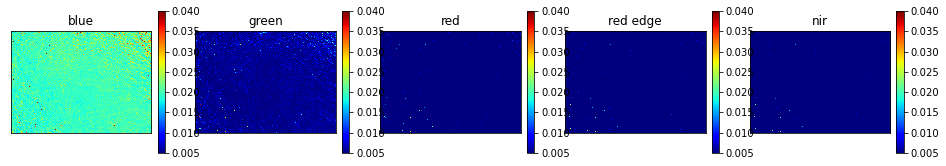

In [85]:
for i in range(0,25):
    visualize_darkest_pixels(sea_imgs[i,:5] - smoothed_lt_lw, lowest_percent=1, max_clim=0.040, min_clim=0.005, only_img=True)

Now let's look at before and after with blue and green bands

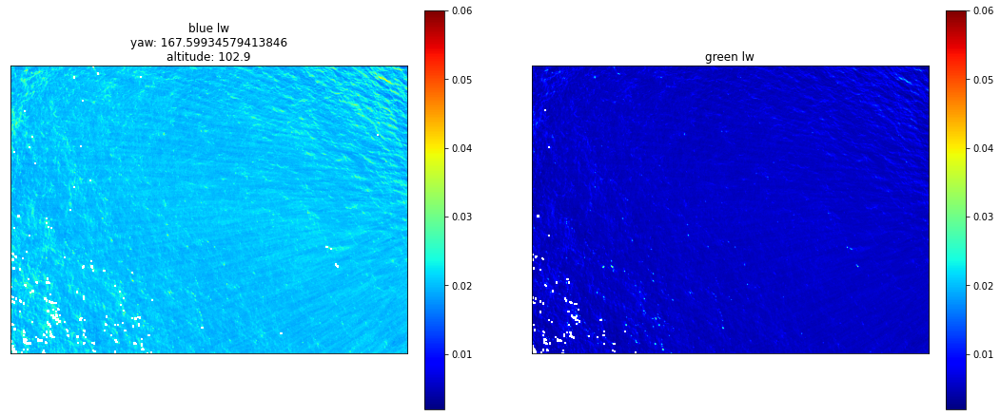

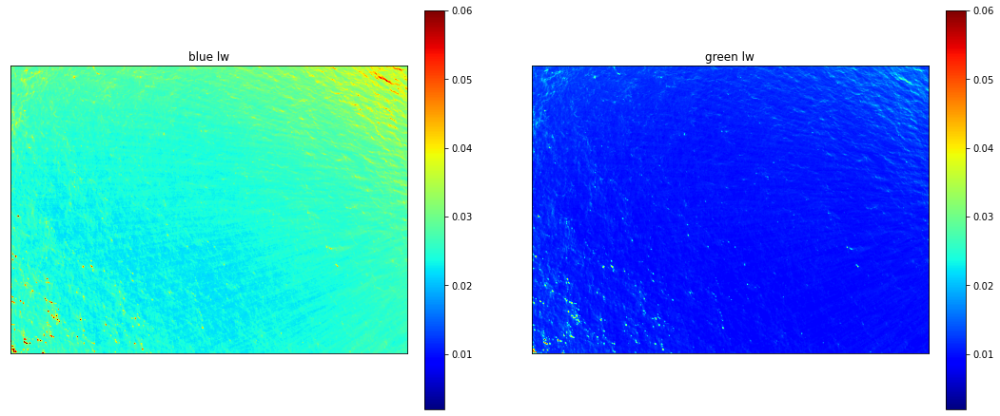

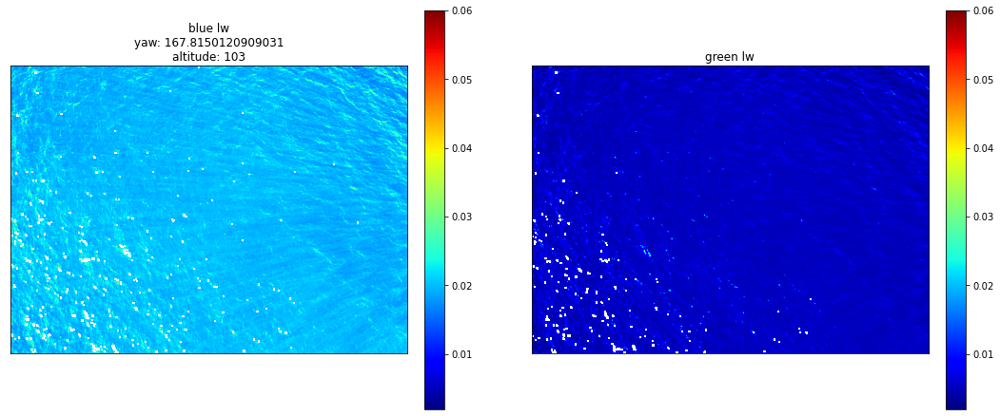

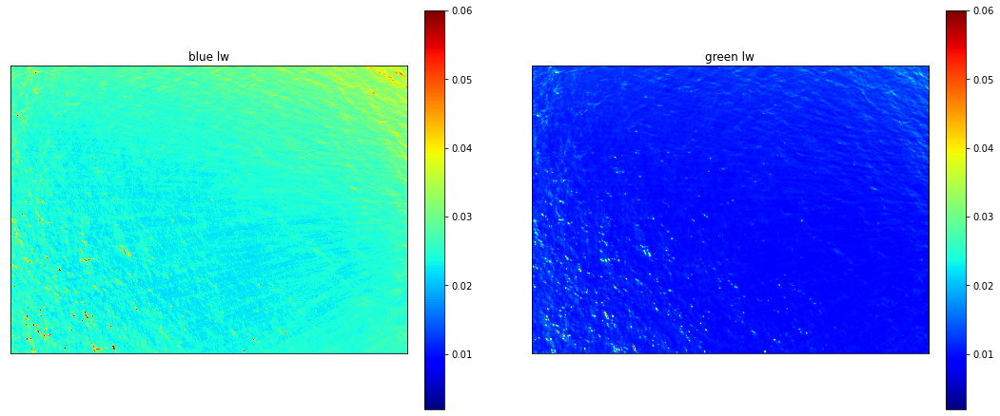

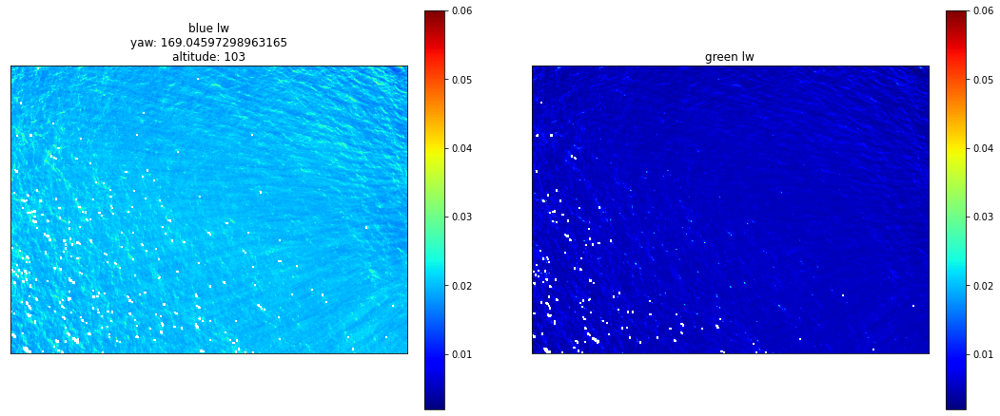

...

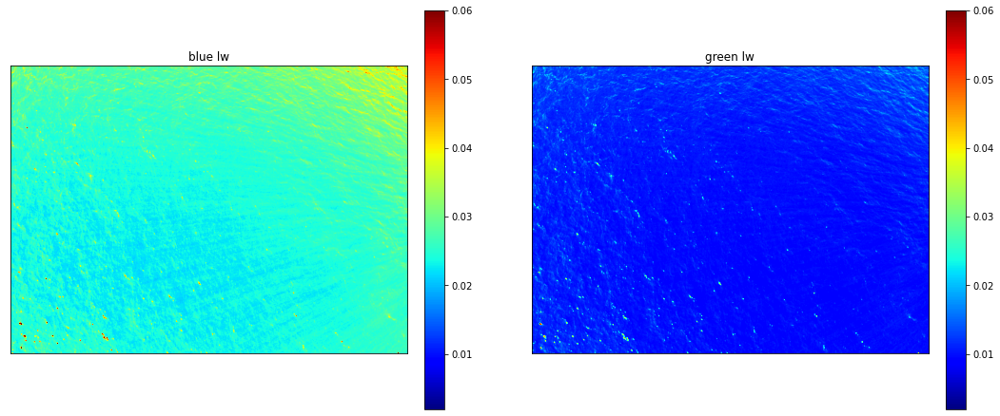

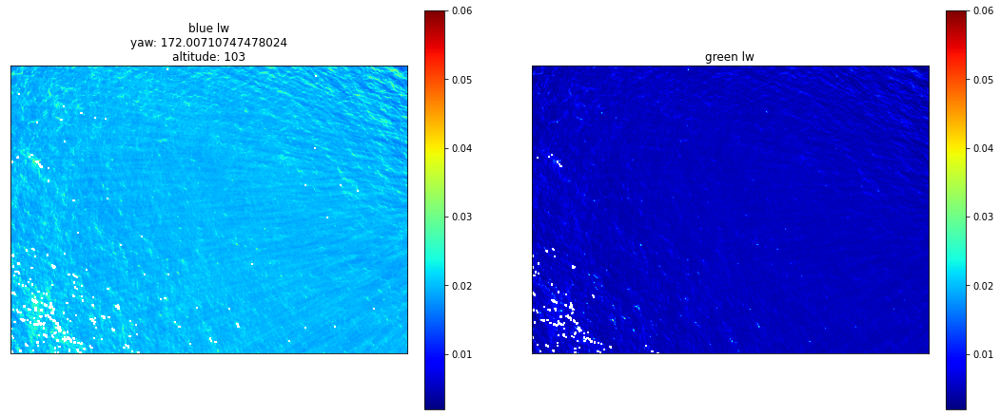

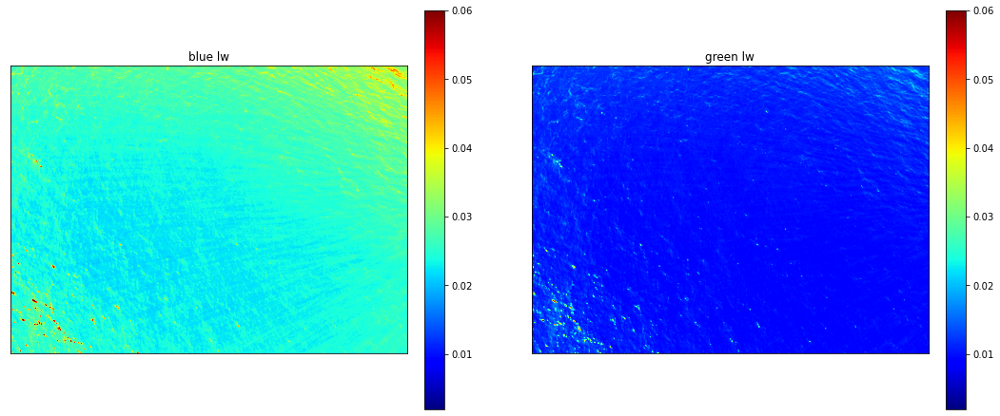

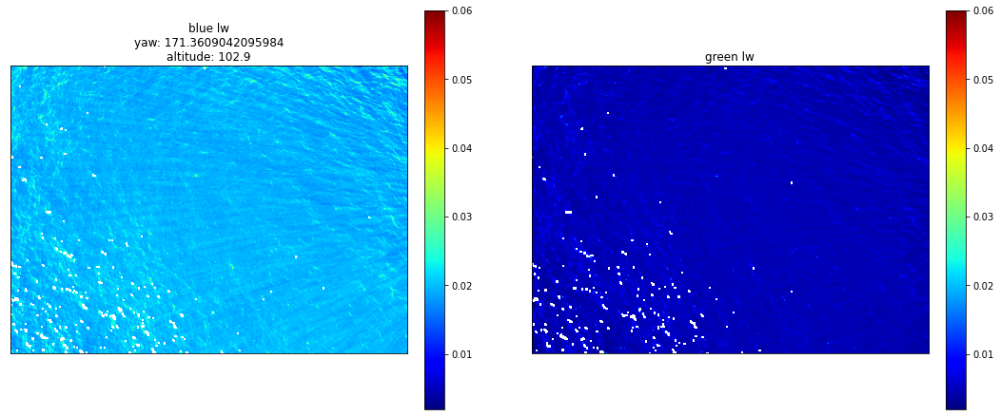

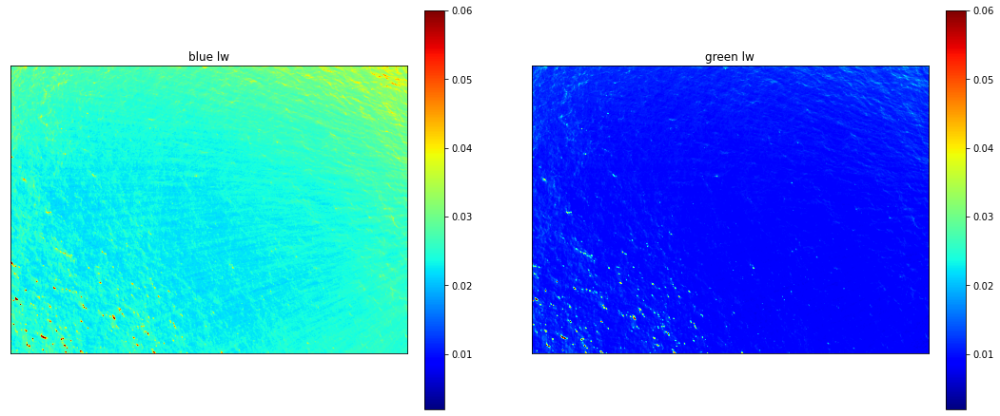

In [86]:
for i in range(18,24):
    fig, ax = plt.subplots(1,2, figsize=(18,8))
    img = sea_imgs[i,:5] - smoothed_lt_lw
    
    img[img > 0.055] = np.nan
    
    
    im = ax[0].imshow(img[0],cmap='jet', vmin=0.002, vmax=.06)
    fig.colorbar(im, ax=ax[0], fraction=0.046, pad=0.04)
    ax[0].set_xticks([])
    ax[0].set_yticks([])
    ax[0].set_title('blue lw\nyaw: ' + str(sea_img_metadata[i]['yaw']) + '\naltitude: ' + str(sea_img_metadata[i]['Altitude']))
    im = ax[1].imshow(img[1],cmap='jet', vmin=0.002, vmax=.06)
    fig.colorbar(im, ax=ax[1], fraction=0.046, pad=0.04)
    ax[1].set_xticks([])
    ax[1].set_yticks([])
    ax[1].set_title('green lw')
    plt.show()
    
    fig, ax = plt.subplots(1,2, figsize=(18,8))
    
    im = ax[0].imshow(sea_imgs[i,0],cmap='jet', vmin=0.002, vmax=.06)
    fig.colorbar(im, ax=ax[0], fraction=0.046, pad=0.04)
    ax[0].set_xticks([])
    ax[0].set_yticks([])
    ax[0].set_title('blue lw')
    im = ax[1].imshow(sea_imgs[i, 1],cmap='jet', vmin=0.002, vmax=.06)
    fig.colorbar(im, ax=ax[1], fraction=0.046, pad=0.04)
    ax[1].set_xticks([])
    ax[1].set_yticks([])
    ax[1].set_title('green lw')
    plt.show()

#### Inspect the spectra from this

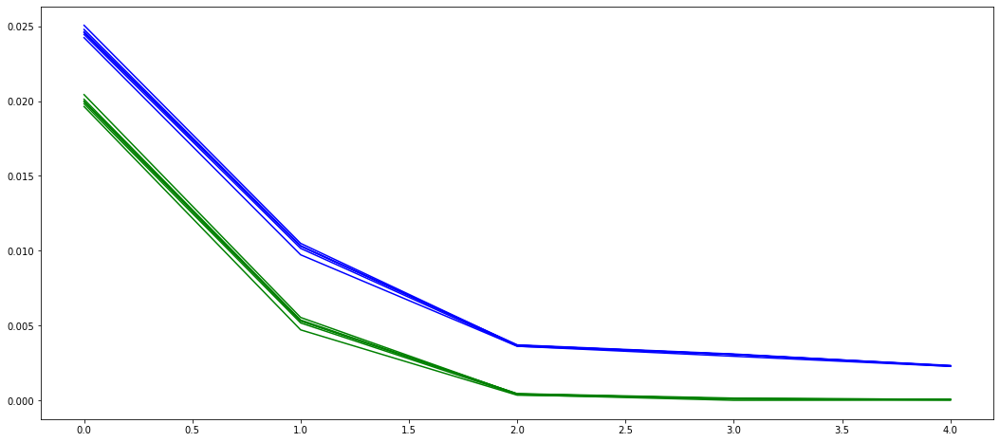

In [87]:
fig, ax = plt.subplots(figsize=(18,8))

for i in range(18,24):
    img = sea_imgs[i,:5] - smoothed_lt_lw
    
#    img[img > 0.055] = np.nan
    
    ax.plot(np.nanmedian(img,axis=(1,2)), color='green')
    ax.plot(np.nanmedian(sea_imgs[i,:5],axis=(1,2)), color='blue')

In [95]:
img = sea_imgs[5,:5].copy() - smoothed_lt_lw
img[np.repeat((img[2] > 0.045)[np.newaxis,:,:],5,axis=0)] = np.nan
    
chla_oci = oc_index(img[0], img[1], img[2])

In [96]:
np.nanmean(img, axis=(1,2))

array([0.01945443, 0.00541122, 0.00039869, 0.00035623, 0.00035143])

In [97]:
chla_oci[chla_oci > 10] = 10

In [98]:
np.nanmean(chla_oci)

0.14476967894326903

In [99]:
np.nanmedian(chla_oci)

0.13532816400224973

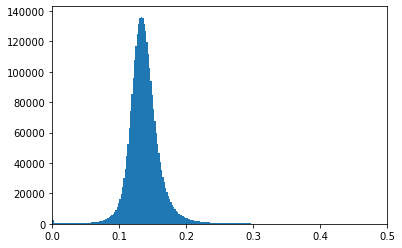

In [100]:
plt.hist(chla_oci.flatten(),  bins=5000)
plt.xlim(0,.5)
plt.show()

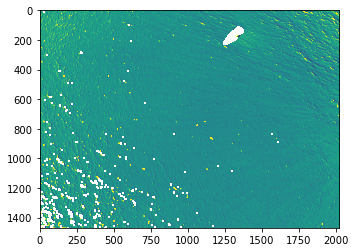

In [101]:
plt.imshow(chla_oci, vmin=np.nanmedian(chla_oci)-0.1, vmax=np.nanmedian(chla_oci)+0.1)

In [102]:
sea_imgs.shape

(60, 6, 1470, 2024)

oc index median is:
0.1224482882286358


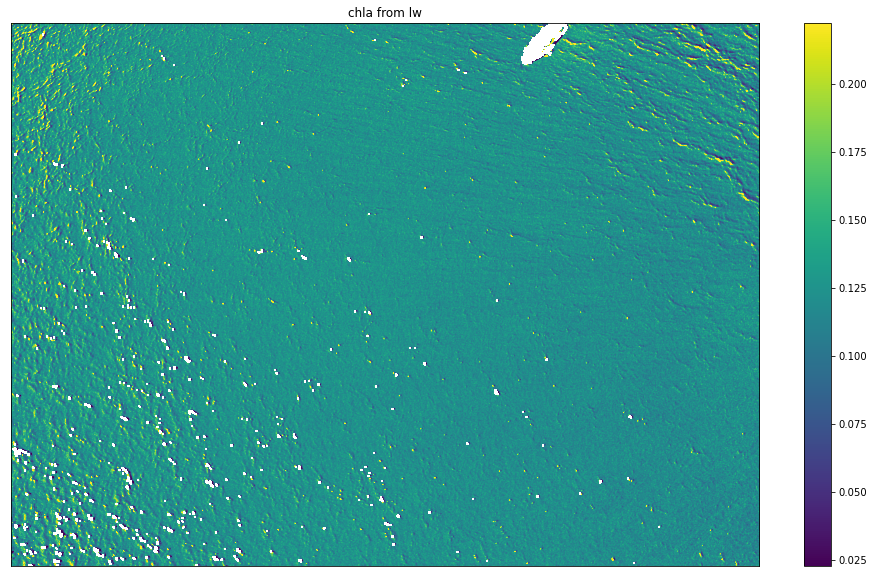

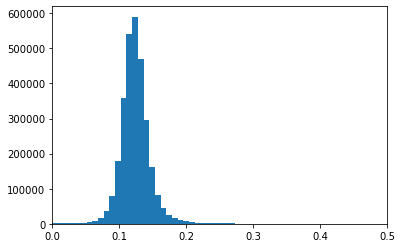

oc index median is:
0.12166429707633139


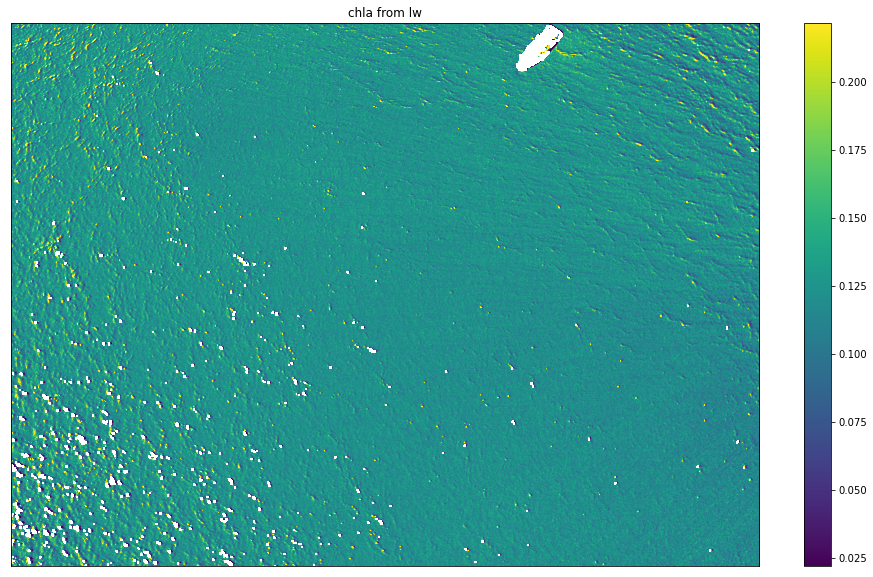

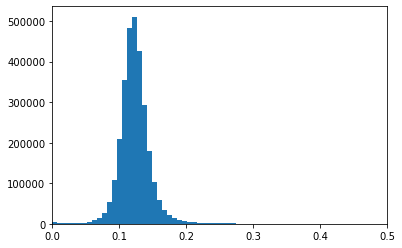

oc index median is:
0.1214137884564262


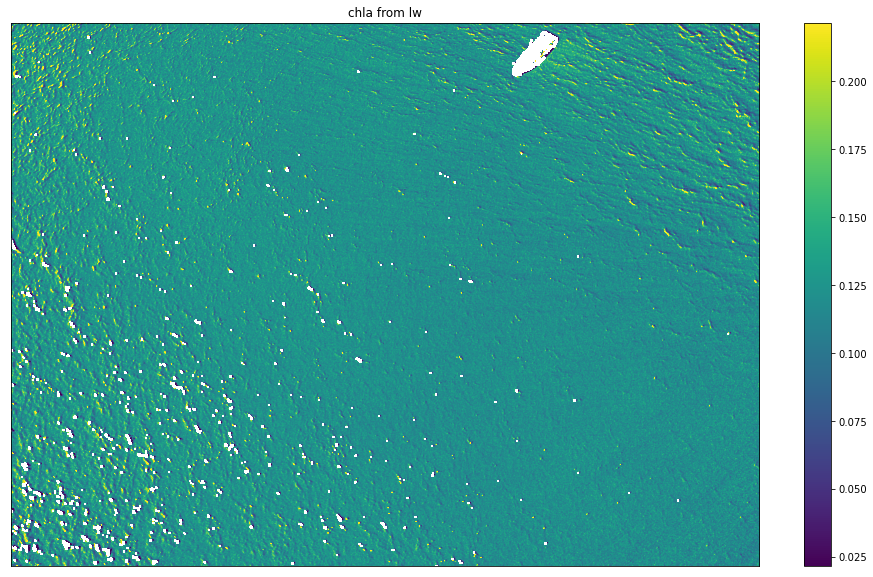

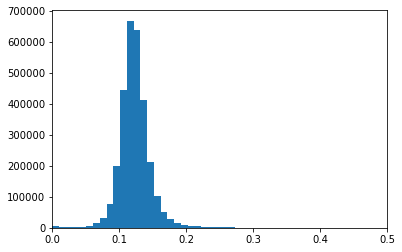

oc index median is:
0.12182255645214865


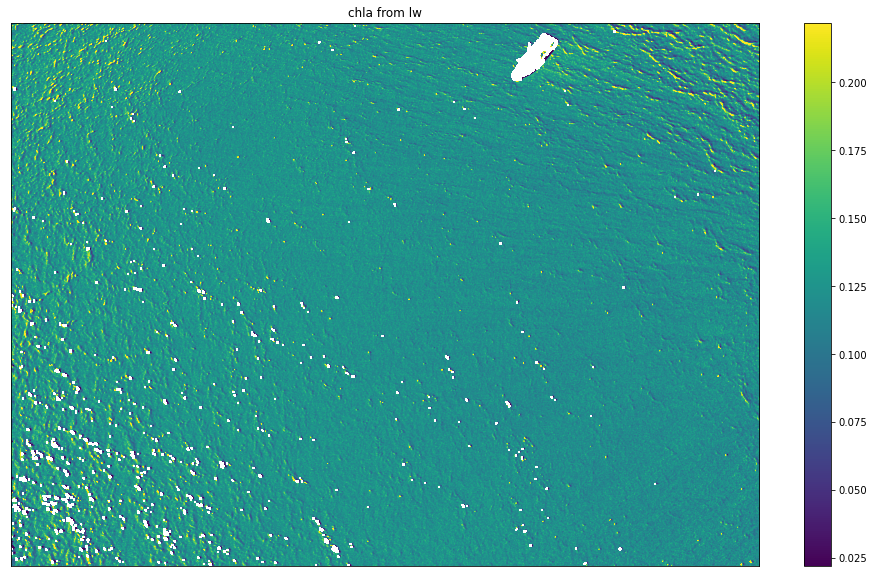

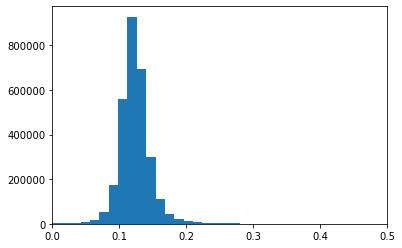

oc index median is:
0.12090208268658922


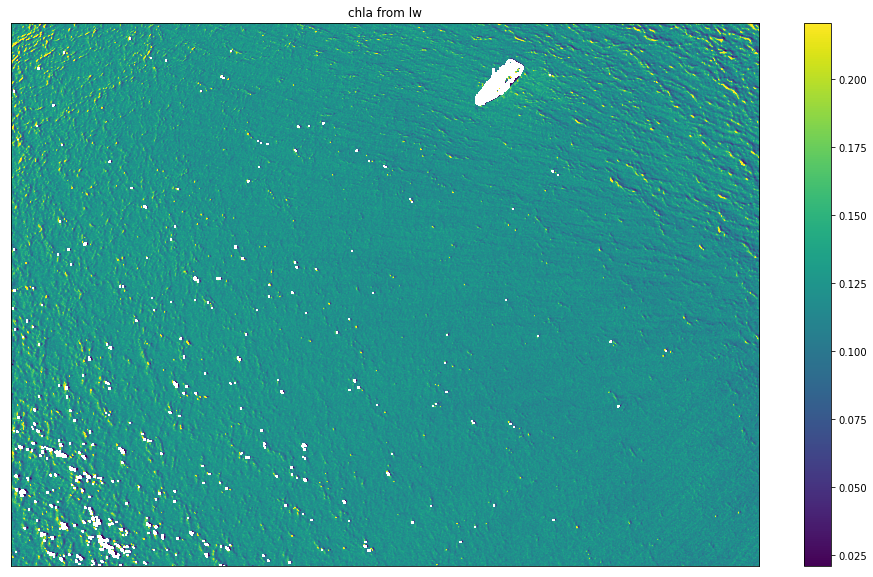

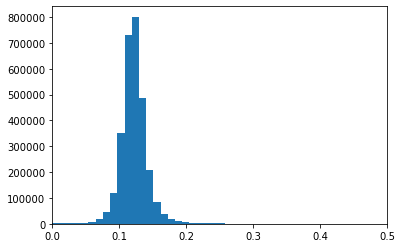

oc index median is:
0.13503531801737392


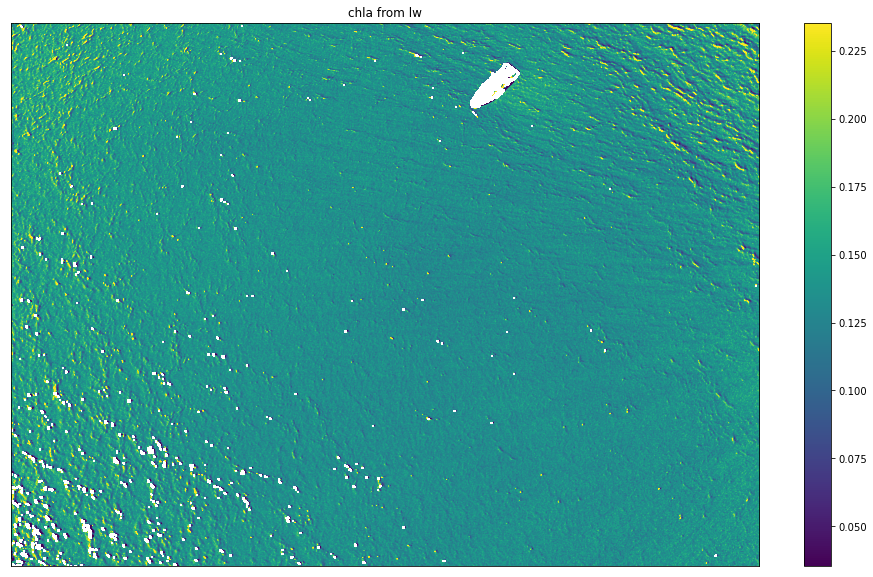

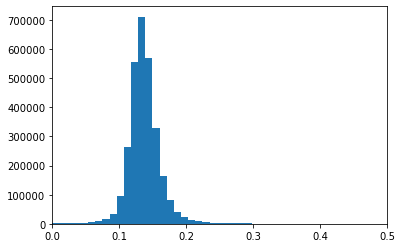

oc index median is:
0.1344561620307059


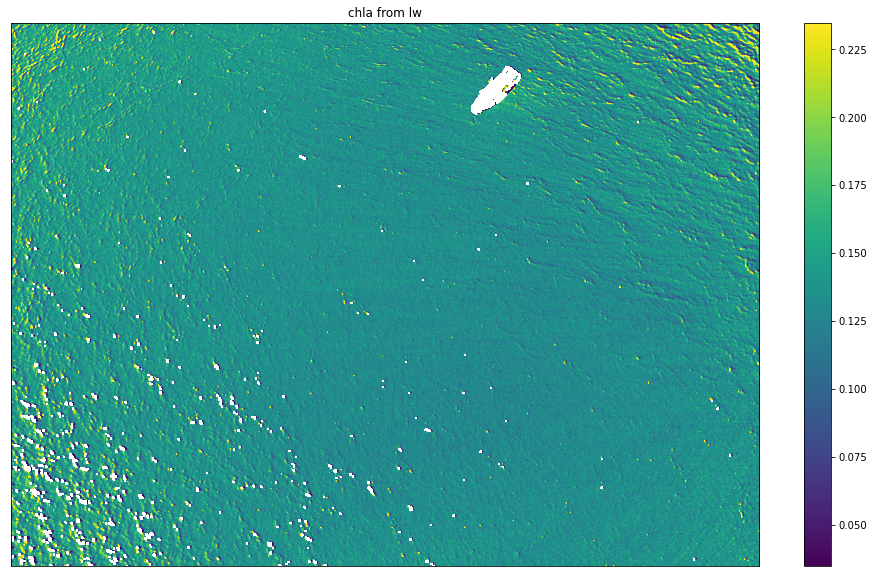

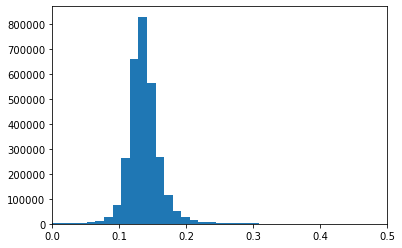

oc index median is:
0.1287874377185893


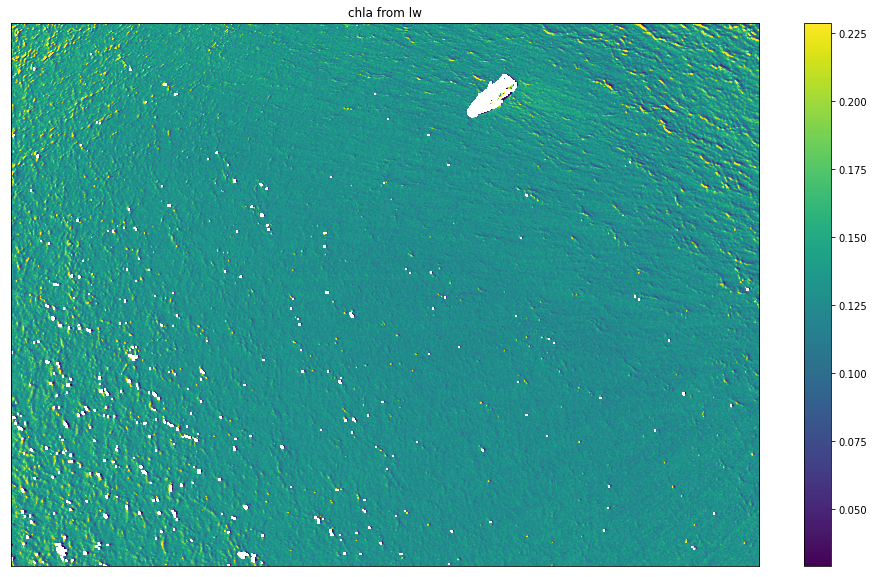

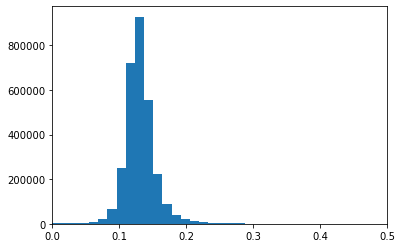

oc index median is:
0.12885585731993374


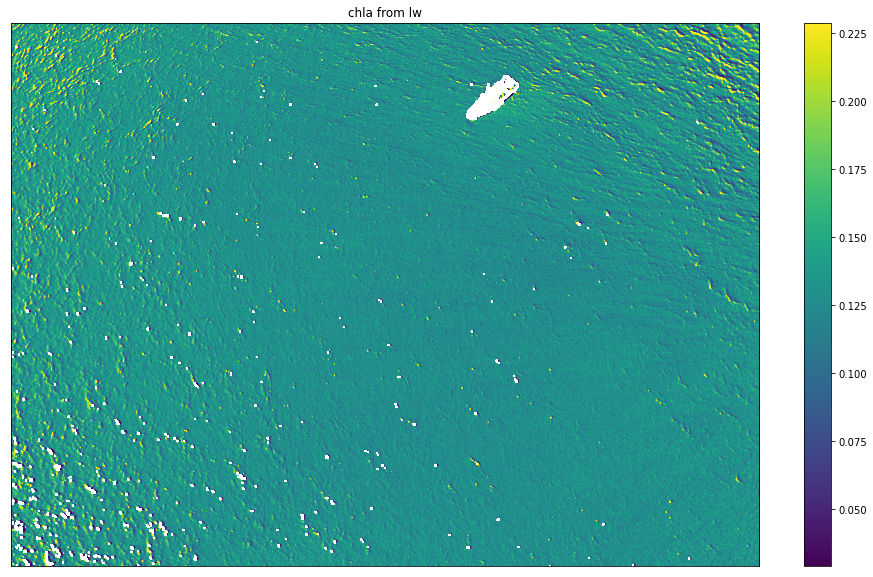

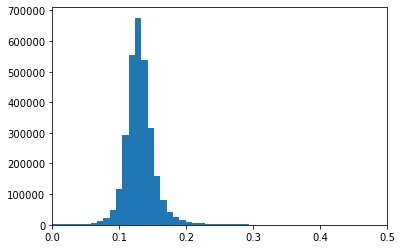

oc index median is:
0.1313142433431827


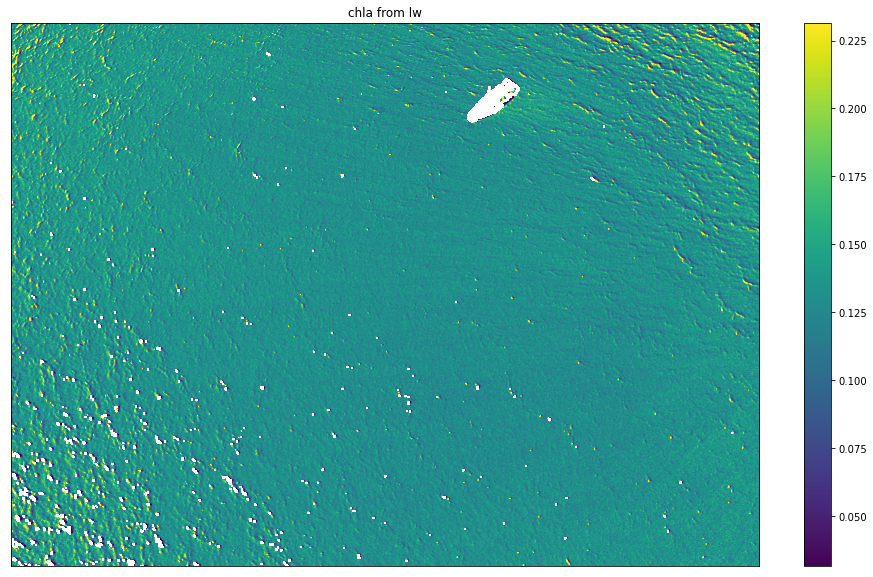

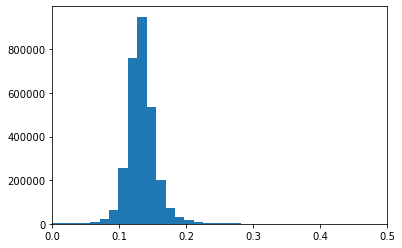

oc index median is:
0.13225636481612565


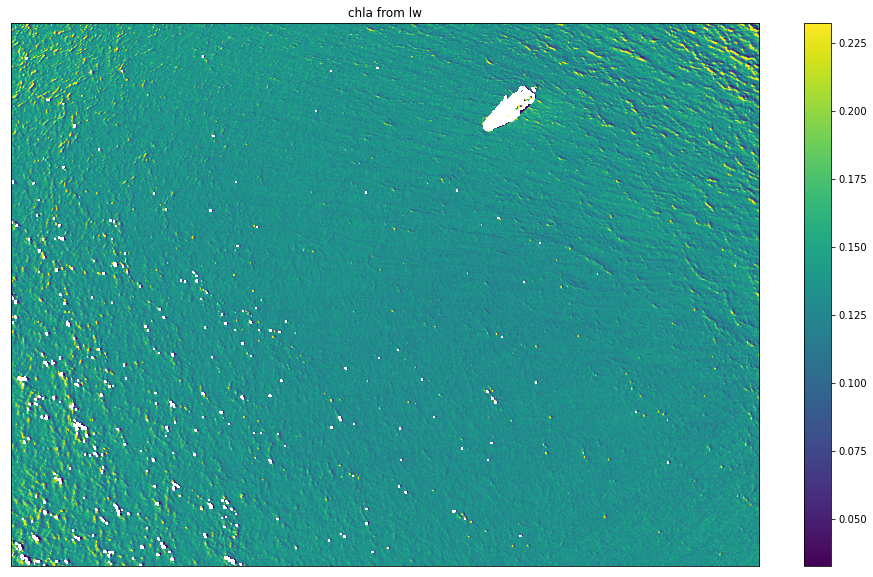

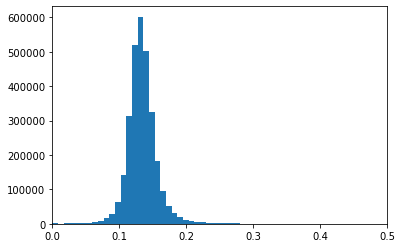

oc index median is:
0.13242026494290815


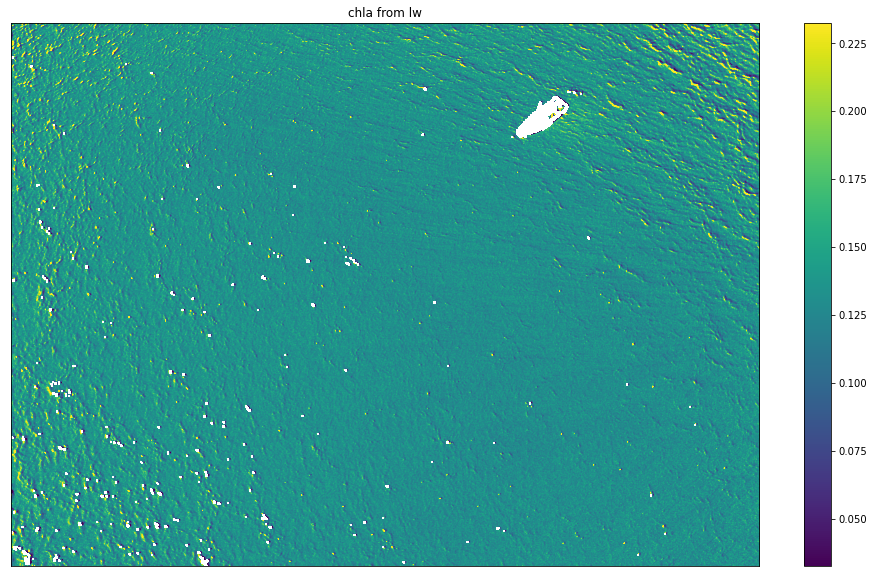

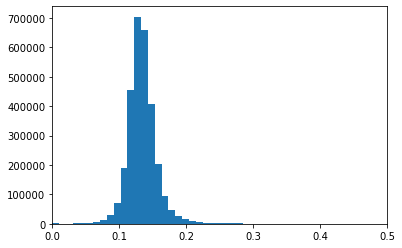

oc index median is:
0.1343418457598101


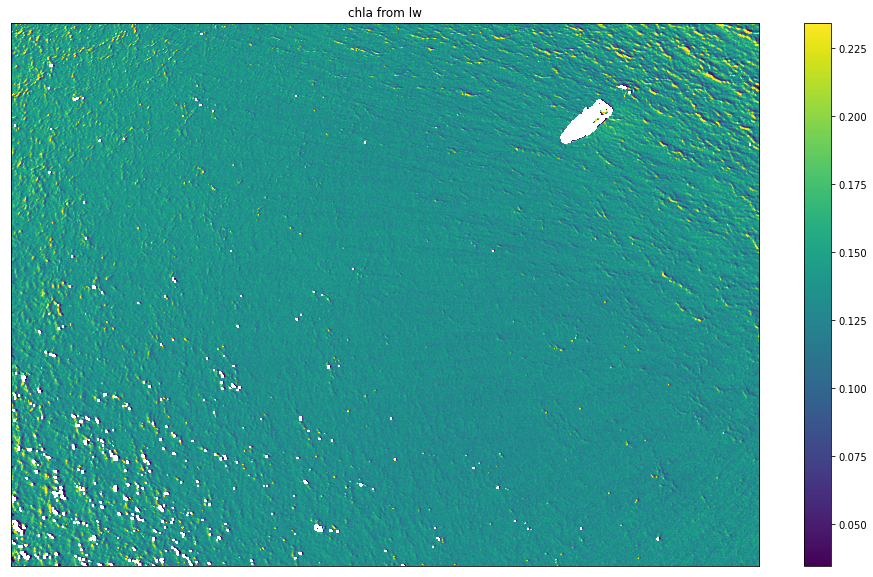

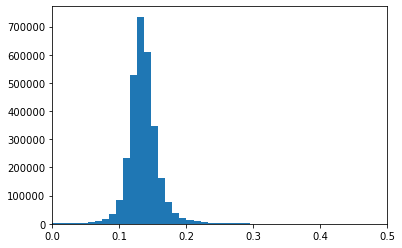

oc index median is:
0.1334657955329914


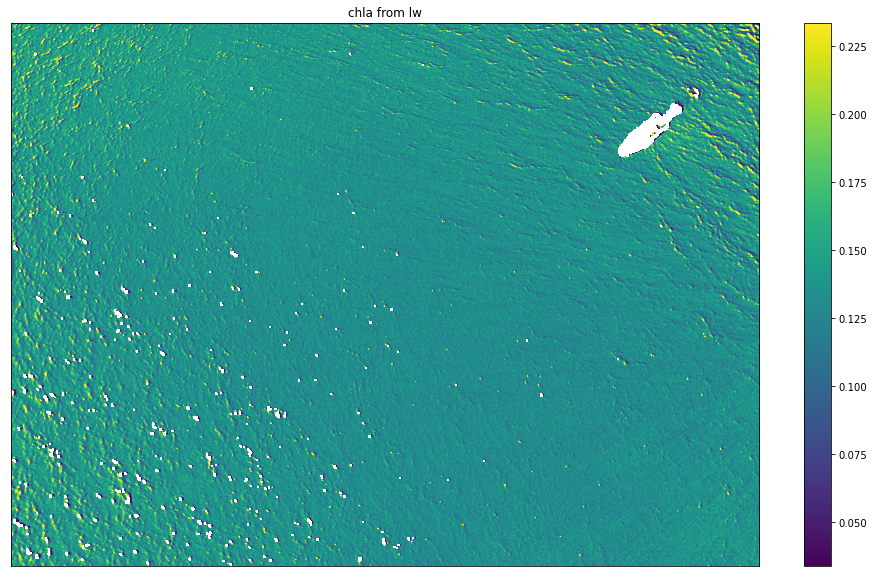

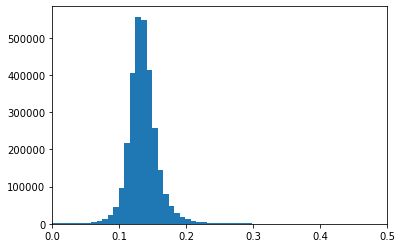

oc index median is:
0.12689977937488195


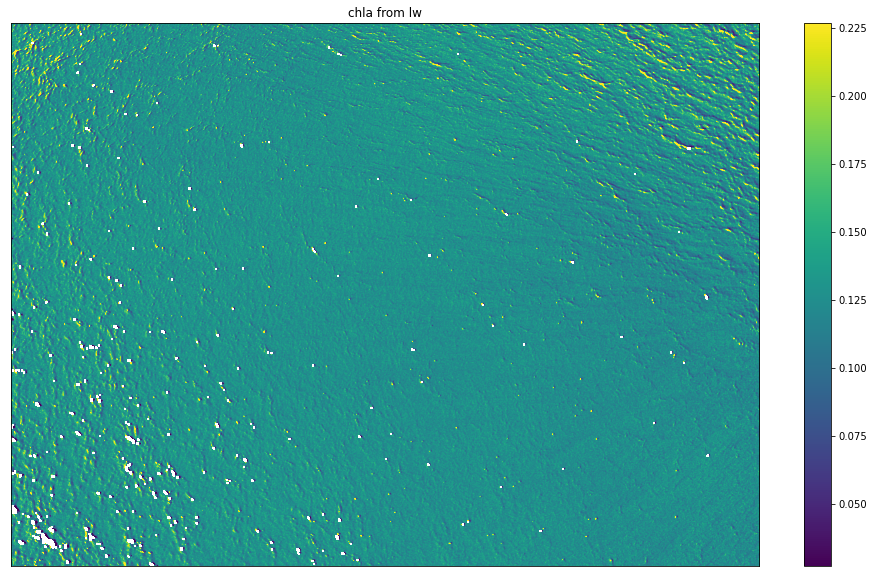

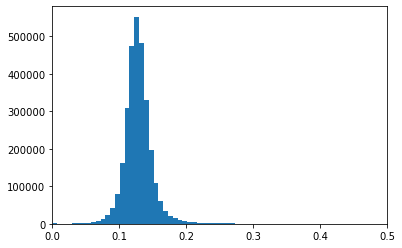

oc index median is:
0.12499192669813607


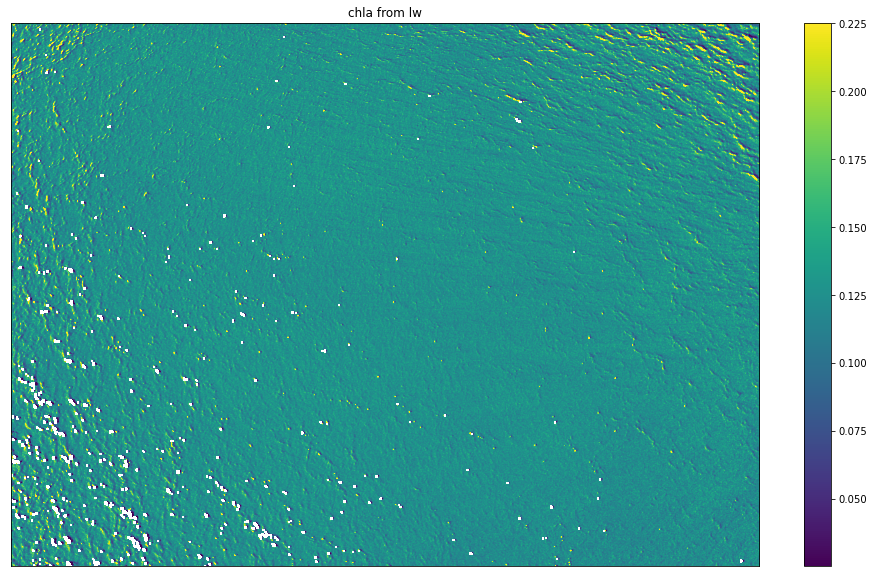

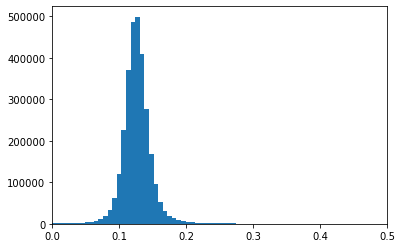

oc index median is:
0.12400337177470927


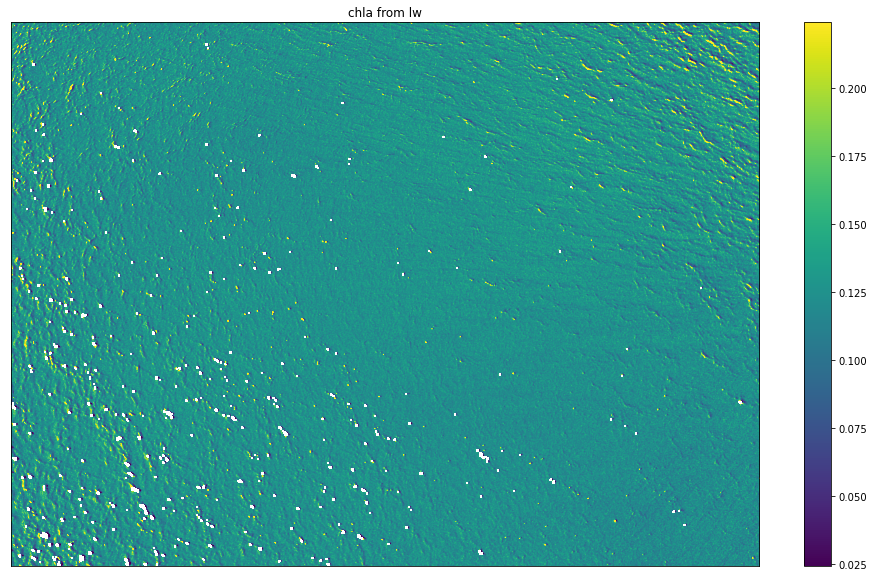

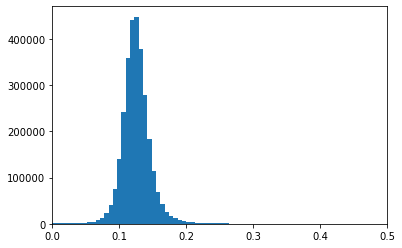

oc index median is:
0.12667665395534486


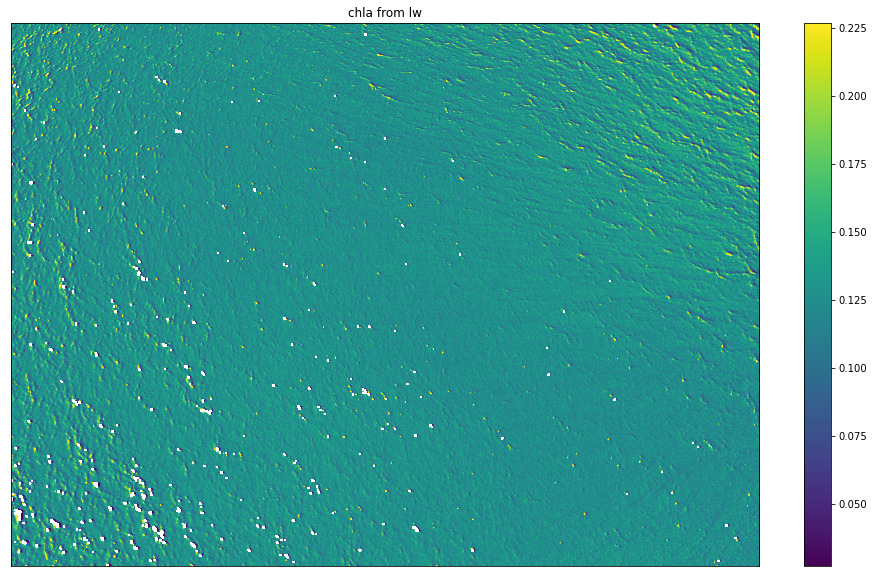

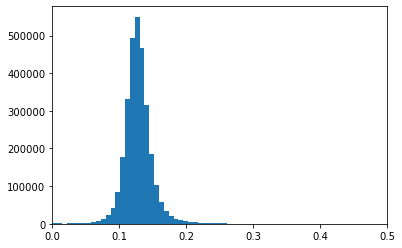

oc index median is:
0.1268180917642336


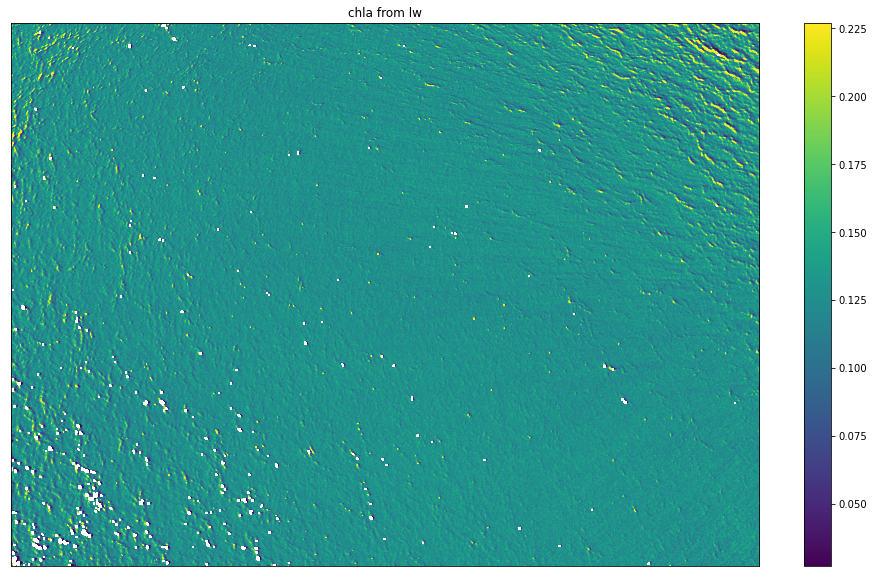

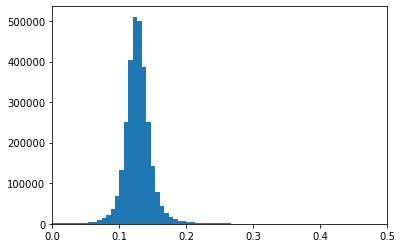

oc index median is:
0.1272175885541678


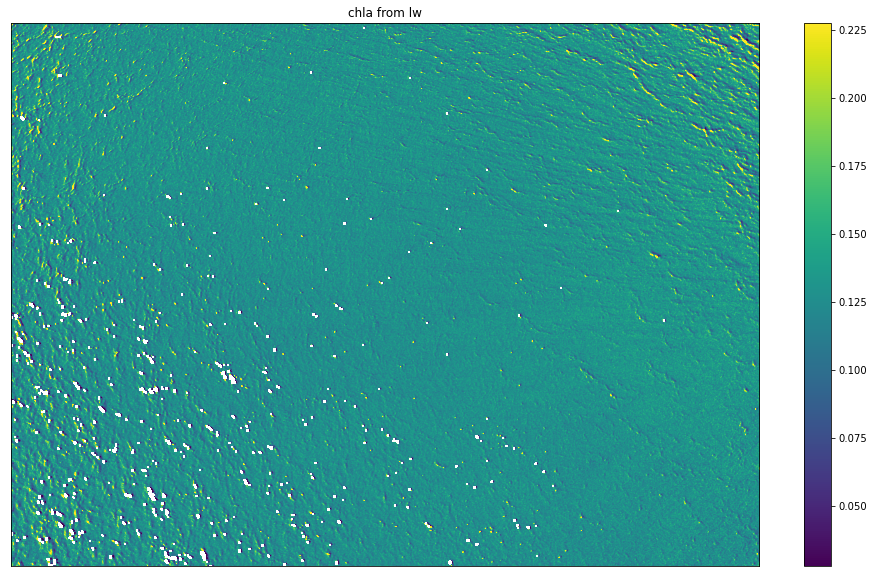

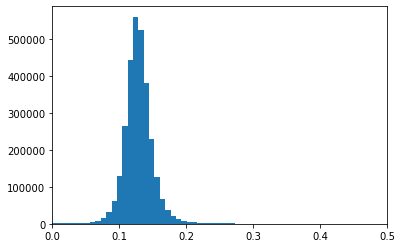

oc index median is:
0.12749305830509702


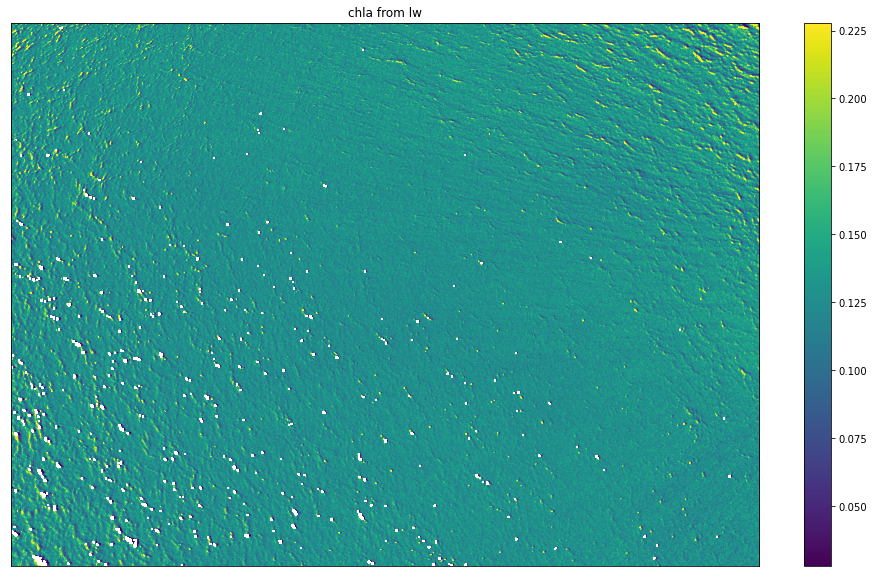

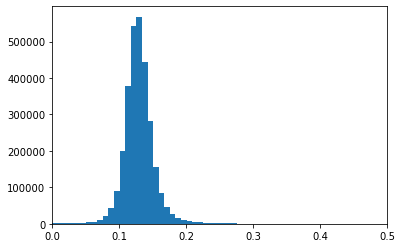

oc index median is:
0.1269078911213755


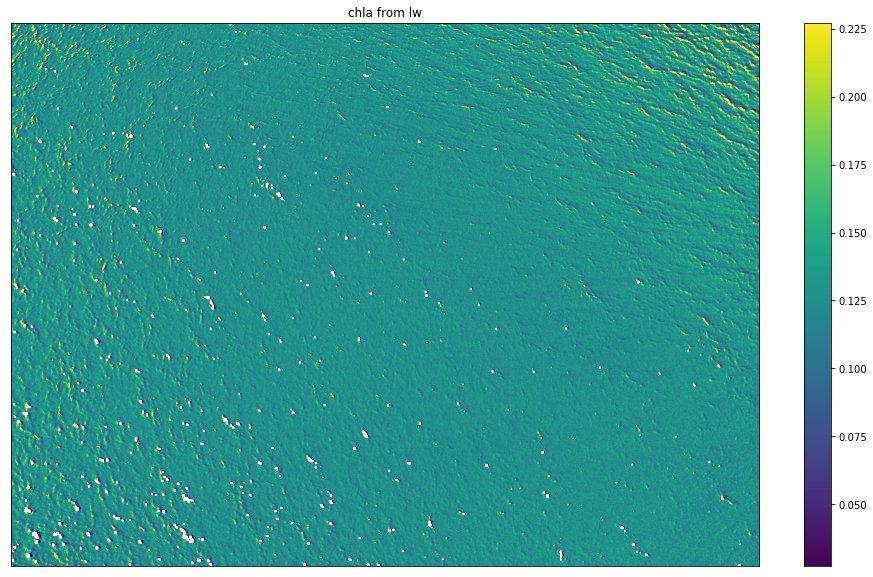

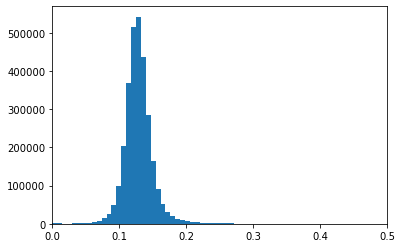

oc index median is:
0.1269464845345725


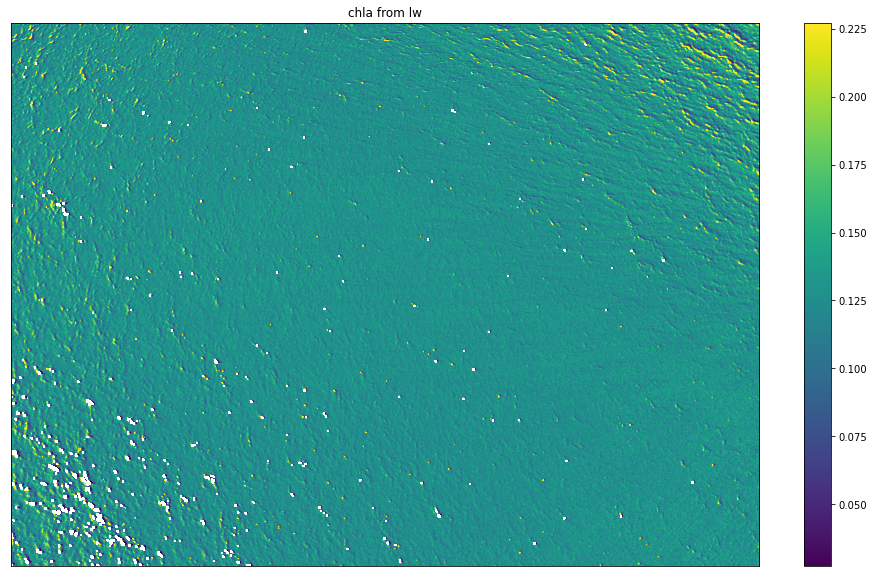

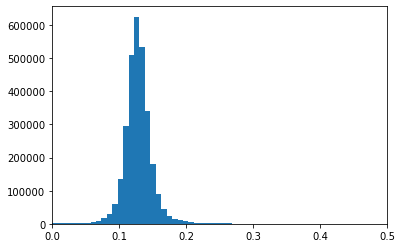

oc index median is:
0.12107424522926806


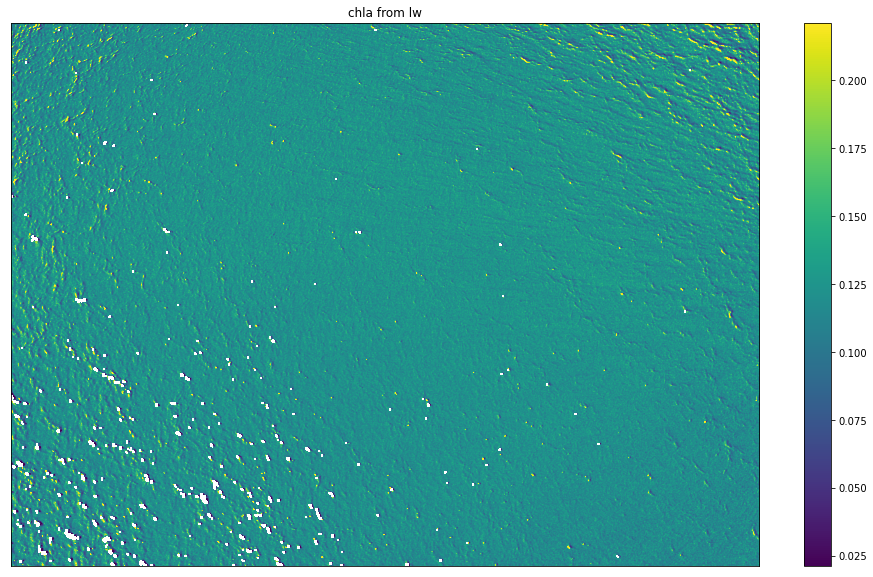

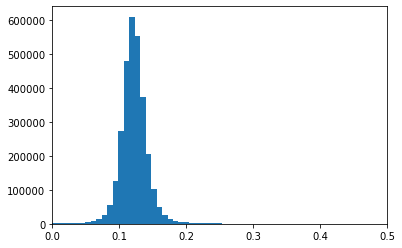

oc index median is:
0.13020771930736408


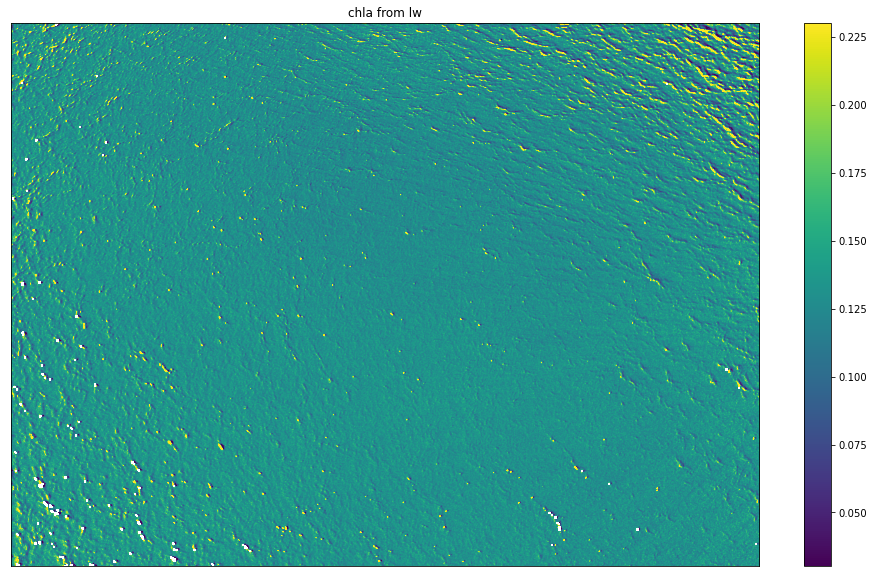

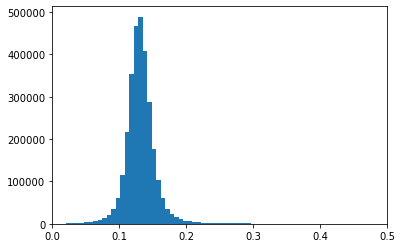

oc index median is:
0.12608554779607514


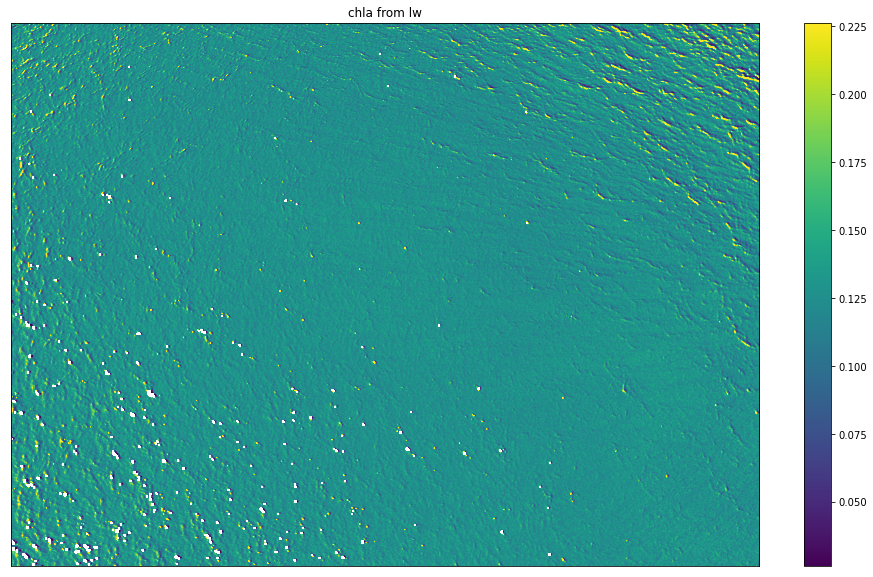

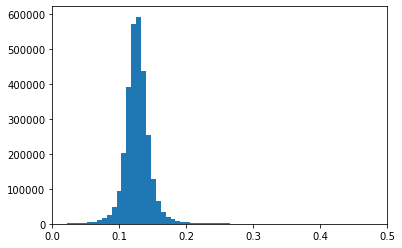

oc index median is:
0.12643369707995739


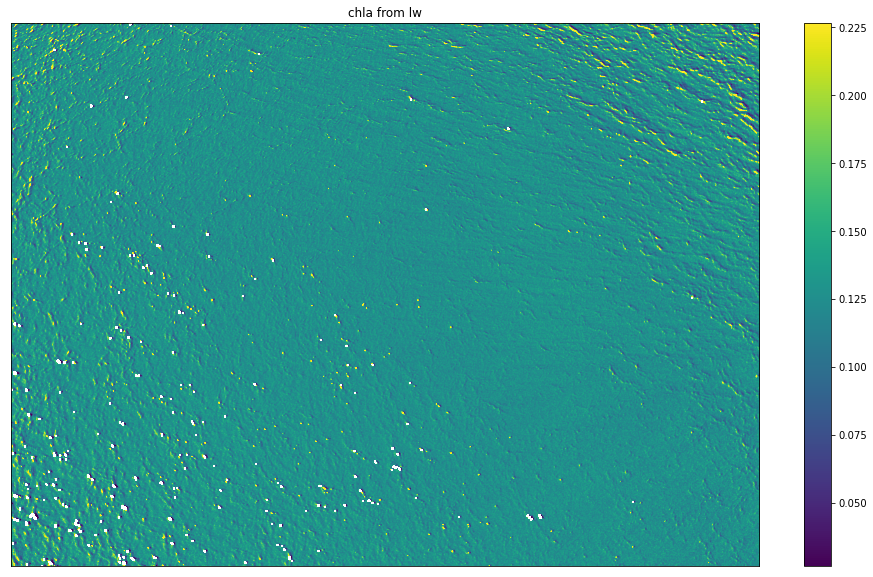

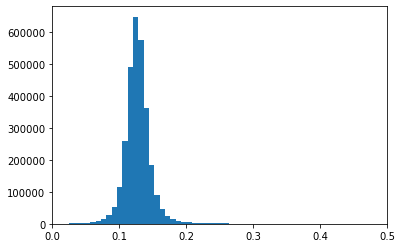

oc index median is:
0.12981851423695162


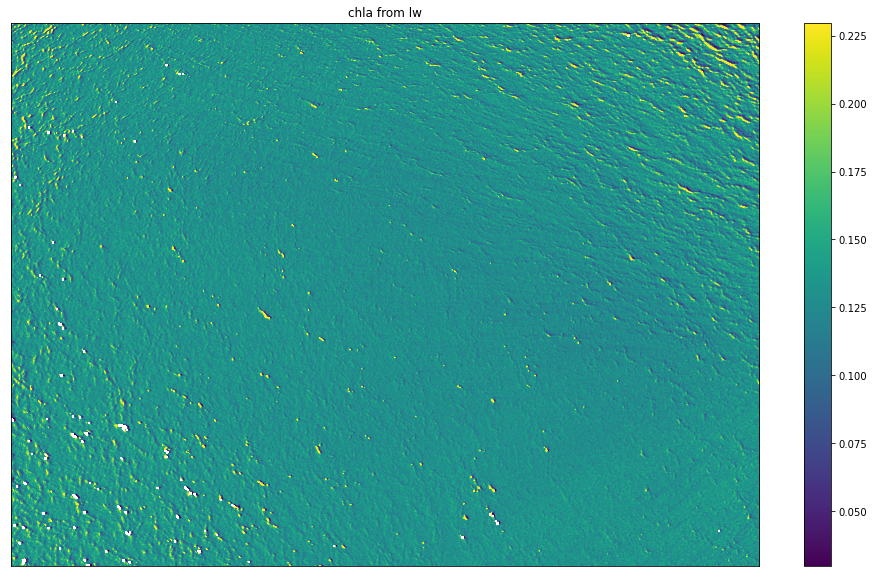

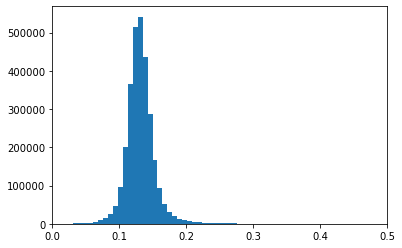

oc index median is:
0.13015437334040172


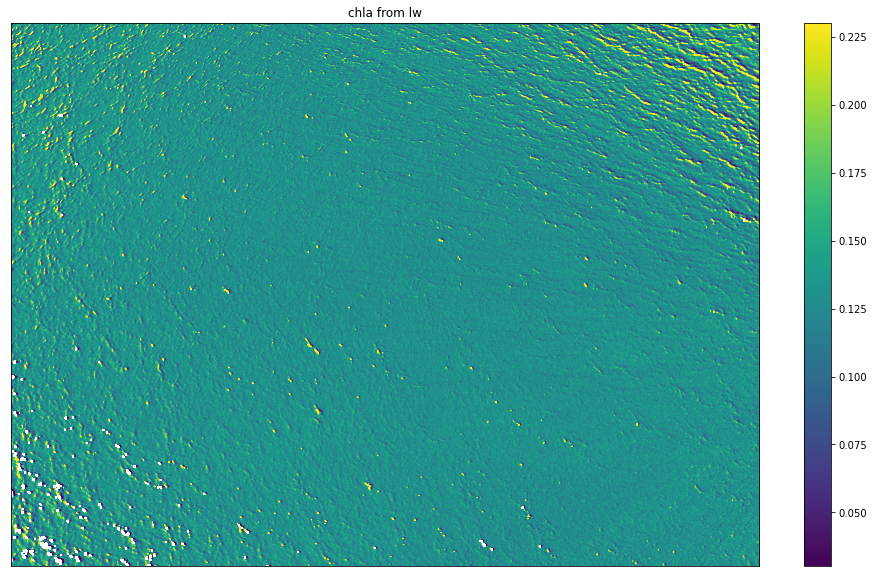

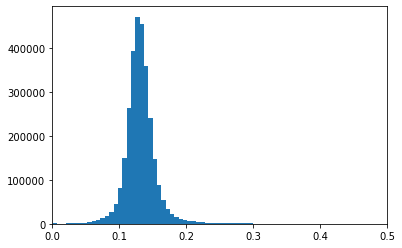

oc index median is:
0.12636765040400258


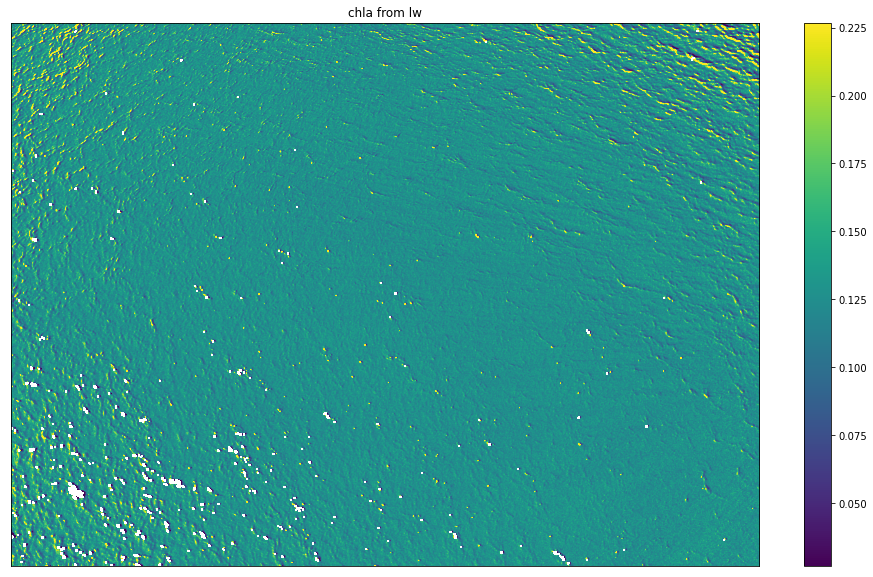

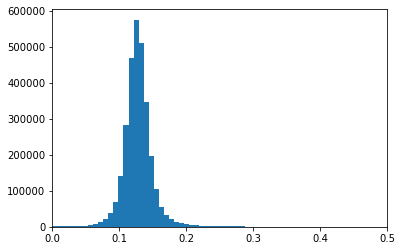

In [103]:
for i in range(0,30):
    fig, ax = plt.subplots(1, figsize=(20,10))
    img = sea_imgs[i,:5].copy() - smoothed_lt_lw
    img[np.repeat((img[1] > 0.03)[np.newaxis,:,:],5,axis=0)] = np.nan
        
    #chla_lw = vec_chla_img(img[0], img[1])
    #chla_lw = chla_lw[:500,:-1600]
    #img = img[:,:500,:-1600]    
    
    chla_oci = oc_index(img[0], img[1], img[2])
    chla_oci[chla_oci<0] = 0
    #chla_oci[chla_oci>4] = np.nan
    
    img_median = np.nanmedian(img, axis=(1,2))
    print('oc index median is:')
    print(oc_index(img_median[0], img_median[1], img_median[2]))
    
    #print(vec_chla_img(img_median[0], img_median[1]))
    #print(np.nanmedian(chla_lw))
    im = ax.imshow(chla_oci,cmap='viridis', vmin=np.nanmedian(chla_oci)-.1, vmax=np.nanmedian(chla_oci)+.1)
    fig.colorbar(im, ax=ax, fraction=0.046, pad=0.04)
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_title('chla from lw')
    plt.show()
    
    plt.hist(chla_oci.flatten(), bins=500)
    plt.xlim(0,.5)
    plt.show()

What does this look like slightly blurred?

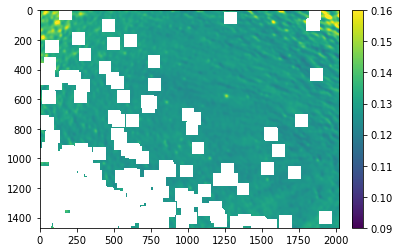

In [106]:
fig,ax = plt.subplots()
im = ax.imshow(ndimage.gaussian_filter(chla_oci, sigma=(9, 9), order=0), cmap='viridis', vmin=0.09, vmax=.16)
fig.colorbar(im, ax=ax, fraction=0.046, pad=0.04)

Fill gaps just to see whole image

In [107]:
# TODO this is not the *ideal* solution
mask = np.isnan(chla_oci)
idx = np.where(~mask,np.arange(mask.shape[1]),0)
np.maximum.accumulate(idx,axis=1, out=idx)
out = chla_oci[np.arange(idx.shape[0])[:,None], idx]

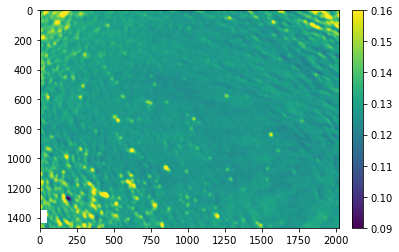

In [108]:
fig,ax = plt.subplots()
im = ax.imshow(ndimage.gaussian_filter(out, sigma=(9, 9), order=0), cmap='viridis', vmin=0.09, vmax=.16)
fig.colorbar(im, ax=ax, fraction=0.046, pad=0.04)

### Inspect the data geographically

Turn each image to a point and put it into a gdf

In [110]:
img = retrieve_imgs_and_metadata(surface_dir, count=1, start=95, altitude_cutoff=0)[0]
sst = img[0,5]

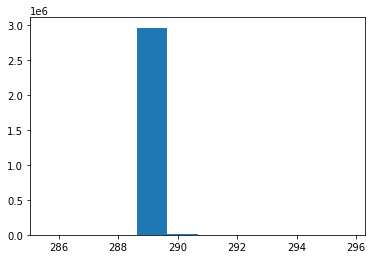

In [111]:
plt.hist((sst* 32768 / 100).flatten())
plt.show()

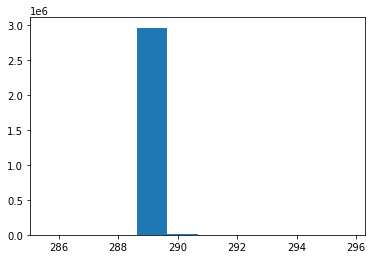

In [112]:
plt.hist((sst* 32768 / 100).flatten())
plt.show()

In [120]:
lats = []
lons = []
chla_list = []
chla_dates = []
temps = []
count = 5
for i in range(95,len(mds)-95):
    count +=1
    if count ==10:
        print('10th image')
        count = 0
    img = retrieve_imgs_and_metadata(surface_dir, count=1, start=i, altitude_cutoff=0)[0]
    
    sst = img[0,5]
    sst_in_k = np.median(sst) * 32768 / 100
#     plt.imshow(sst* 32768 / 100, vmin=288,vmax=292)
#     print(sst_in_k)
#     plt.show()
    
    img = img[0,:5,:,:] - smoothed_lt_lw
    #img = sea_imgs[i,:5].copy() 
    #img[np.repeat((img[1] > 0.03)[np.newaxis,:,:],5,axis=0)] = np.nan
    #chla_oci = oc_index(img[0], img[1], img[2])
    #chla_oci[chla_oci<0] = 0
    #chla_oci[chla_oci>4] = np.nan
    img_median = np.nanmedian(img, axis=(1,2))
    oc_med = oc_index(img_median[0], img_median[1], img_median[2])

    chla_list.append(oc_med)
    lats.append(mds[i]['Latitude'])
    lons.append(mds[i]['Longitude'])
    chla_dates.append(datetime.datetime.strptime(mds[i]['Date']+' - '+mds[i]['UTC-Time'], '%m/%d/%Y - %H:%M:%S'))
    temps.append(sst_in_k)

10th image
10th image
10th image
10th image
10th image
10th image
10th image
10th image
10th image
10th image
10th image
10th image
10th image
10th image
10th image
10th image
10th image
10th image
10th image
10th image
10th image
10th image
10th image
10th image
10th image
10th image


In [121]:
len(chla_list)

259

<AxesSubplot:>

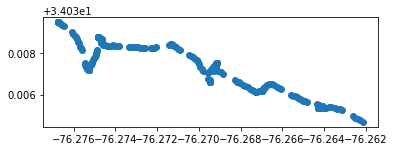

In [122]:
import geopandas as gpd
chla_df = pd.DataFrame(
    {'chla': chla_list,
     'Latitude': lats,
     'Longitude': lons,
     'time' : chla_dates,
     'sst' : temps
    })

chla_gdf = gpd.GeoDataFrame(
    chla_df, geometry=gpd.points_from_xy(chla_df.Longitude, chla_df.Latitude))
chla_gdf.plot()

<AxesSubplot:>

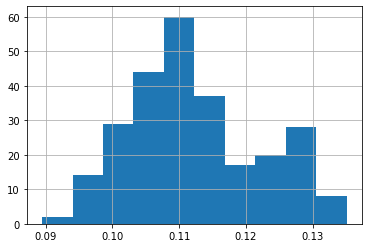

In [123]:
chla_gdf['chla'].hist()

<AxesSubplot:>

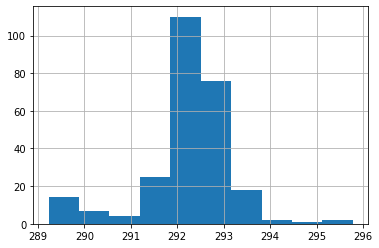

In [124]:
chla_gdf['sst'].hist()

<AxesSubplot:>

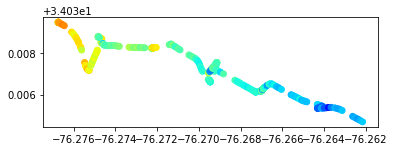

In [128]:
chla_gdf.plot(column=chla_gdf['chla'],vmin=0.08, vmax=0.15, cmap='jet')

<AxesSubplot:>

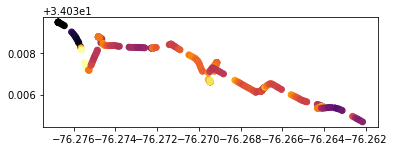

In [130]:
chla_gdf.plot(column=chla_gdf['sst'],vmin=290, vmax=294, cmap='inferno')

In [131]:
chla_gdf['time_str'] = chla_gdf['time'].astype(str)

In [132]:
chla_gdf.drop('time', 1).to_file('chla_sst_flight1.shp')

### Write out the data as .tifs

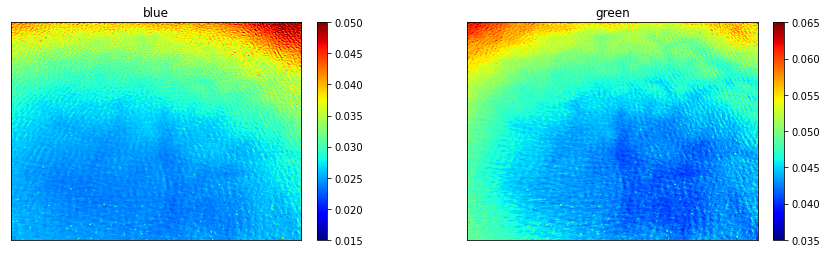

/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3427: FutureWarning: Indexing a timezone-naive DatetimeIndex with a timezone-aware datetime is deprecated and will raise KeyError in a future version.  Use a timezone-naive object instead.
  exec(code_obj, self.user_global_ns, self.user_ns)


34.7138816 -76.6757056 47.83 -74.5 0 40
0.05
img coords:  [[ 258.3914646  2348.50889259]
 [ 686.43797456  805.02304135]
 [1762.20844904 1473.83633639]
 [1525.06358628 2328.95308621]]
initial profile
{'driver': 'GTiff', 'dtype': 'uint16', 'nodata': None, 'width': 2064, 'height': 1544, 'count': 1, 'crs': None, 'transform': Affine(1.0, 0.0, 0.0,
       0.0, 1.0, 0.0), 'tiled': False, 'interleave': 'band'}
updated profile
{'driver': 'GTiff', 'dtype': 'float32', 'nodata': None, 'width': 4000, 'height': 4000, 'count': 1, 'crs': 'EPSG:4326', 'transform': Affine(3.5185429974500584e-12, 5.470247326852344e-07, -76.6767996560071,
       -4.4965761414818946e-07, 2.387899005108411e-12, 34.7147809111126), 'tiled': False, 'interleave': 'band'}
written out as  blue_georeg_finerLKLBZ1Ww6EphUE56L9ZR.tif
Complete!


/home/clifgray/Code/ocean_color/georeg.py:66: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.
  
/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/rasterio/__init__.py:218: NotGeoreferencedWarning: Dataset has no geotransform set. The identity matrix may be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)
/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3427: FutureWarning: Indexing a timezone-naive DatetimeIndex with a timezone-aware datetime is deprecated and will raise KeyError in a future version.  Use a timezone-naive object instead.
  exec(code_obj, self.user_global_ns, self.user_ns)


34.7138816 -76.6757056 47.83 -74.5 0 40
0.05
img coords:  [[ 258.3914646  2348.50889259]
 [ 686.43797456  805.02304135]
 [1762.20844904 1473.83633639]
 [1525.06358628 2328.95308621]]
initial profile
{'driver': 'GTiff', 'dtype': 'uint16', 'nodata': None, 'width': 2064, 'height': 1544, 'count': 1, 'crs': None, 'transform': Affine(1.0, 0.0, 0.0,
       0.0, 1.0, 0.0), 'tiled': False, 'interleave': 'band'}
updated profile
{'driver': 'GTiff', 'dtype': 'float32', 'nodata': None, 'width': 4000, 'height': 4000, 'count': 1, 'crs': 'EPSG:4326', 'transform': Affine(3.5185429974500584e-12, 5.470247326852344e-07, -76.6767996560071,
       -4.4965761414818946e-07, 2.387899005108411e-12, 34.7147809111126), 'tiled': False, 'interleave': 'band'}
written out as  green_georeg_finerLKLBZ1Ww6EphUE56L9ZR.tif
Complete!


/home/clifgray/Code/ocean_color/georeg.py:66: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.
  
/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/rasterio/__init__.py:218: NotGeoreferencedWarning: Dataset has no geotransform set. The identity matrix may be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


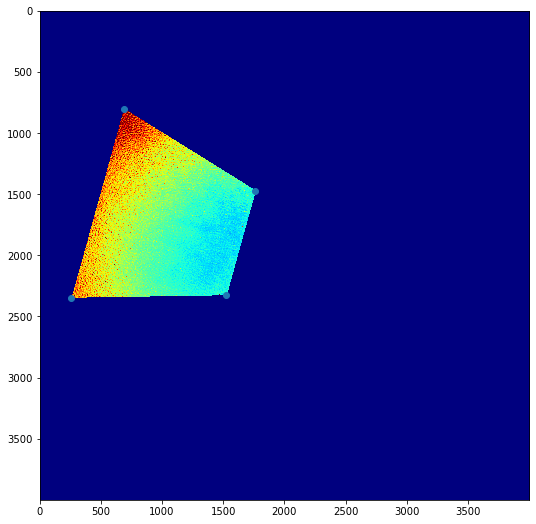

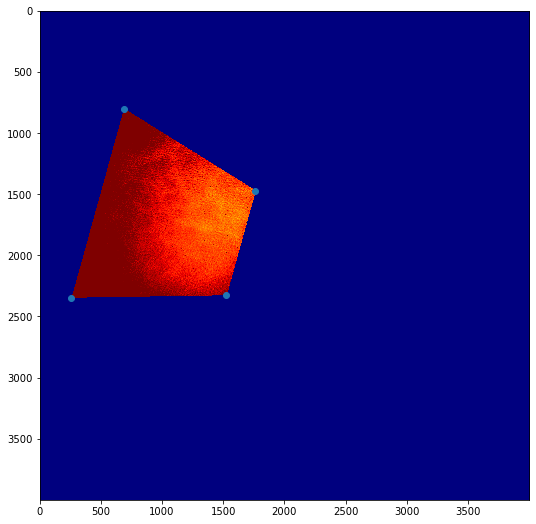

In [59]:
from skimage.transform import resize

for i in range(15):
    
    # form is [x_min, x_max, y_min, y_max]
    top_im_bounds=[-100,100,-100,100]
    
    original_img = plt.imread(sea_img_metadata[i]['image_name'])
    resized_blue = resize(sea_imgs[i,0], (original_img.shape[0], original_img.shape[1]), anti_aliasing=True)
    resized_green = resize(sea_imgs[i,1], (original_img.shape[0], original_img.shape[1]), anti_aliasing=True)
    
    resized_blue[resized_blue < 0] = 0
    resized_green[resized_green < 0] = 0
    
    fig, ax = plt.subplots(1,2, figsize=(15,4))
    im = ax[0].imshow(resized_blue,cmap='jet', vmin=0.015, vmax=.05)
    fig.colorbar(im, ax=ax[0], fraction=0.046, pad=0.04)
    ax[0].set_xticks([])
    ax[0].set_yticks([])
    ax[0].set_title('blue')
    
    im = ax[1].imshow(resized_green,cmap='jet', vmin=0.035, vmax=.065)
    fig.colorbar(im, ax=ax[1], fraction=0.046, pad=0.04)
    ax[1].set_xticks([])
    ax[1].set_yticks([])
    ax[1].set_title('green')
    plt.show()
    new_name = 'blue_georeg_finer' + sea_img_metadata[i]['filename']
    alta_micasense_georef(sea_img_metadata[i]['image_name'], new_name, resized_blue, alta_logs, top_im_bounds=top_im_bounds, scaling=0.05)
    new_name = 'green_georeg_finer' + sea_img_metadata[i]['filename']
    alta_micasense_georef(sea_img_metadata[i]['image_name'], new_name, resized_green, alta_logs, top_im_bounds=top_im_bounds, scaling=0.05)
    
    break

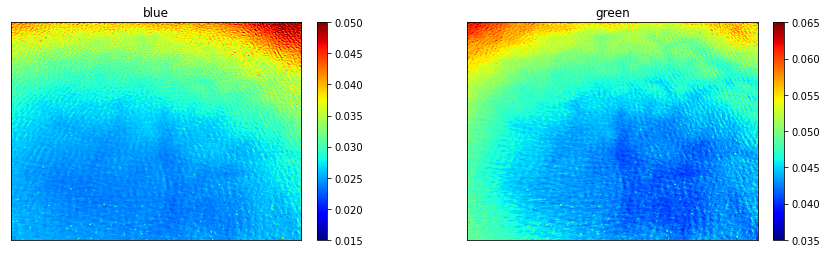

/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3427: FutureWarning: Indexing a timezone-naive DatetimeIndex with a timezone-aware datetime is deprecated and will raise KeyError in a future version.  Use a timezone-naive object instead.
  exec(code_obj, self.user_global_ns, self.user_ns)


34.7138816 -76.6757056 47.83 -74.5 0 40
0.05
img coords:  [[-441.6085354  1548.50889259]
 [ -13.56202544    5.02304135]
 [1062.20844904  673.83633639]
 [ 825.06358628 1528.95308621]]
initial profile
{'driver': 'GTiff', 'dtype': 'uint16', 'nodata': None, 'width': 2064, 'height': 1544, 'count': 1, 'crs': None, 'transform': Affine(1.0, 0.0, 0.0,
       0.0, 1.0, 0.0), 'tiled': False, 'interleave': 'band'}
updated profile
{'driver': 'GTiff', 'dtype': 'float32', 'nodata': None, 'width': 2600, 'height': 2400, 'count': 1, 'crs': 'EPSG:4326', 'transform': Affine(3.5185429974500584e-12, 5.470247326852344e-07, -76.67641673587939,
       -4.4965761414818946e-07, 2.387899005108411e-12, 34.7144211866928), 'tiled': False, 'interleave': 'band'}
written out as  blue_georeg_finerLKLBZ1Ww6EphUE56L9ZR.tif
Complete!
34.7138816 -76.6757056 47.83 -74.5 0 40
0.05


/home/clifgray/Code/ocean_color/georeg.py:66: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.
  
/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/rasterio/__init__.py:218: NotGeoreferencedWarning: Dataset has no geotransform set. The identity matrix may be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)
/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3427: FutureWarning: Indexing a timezone-naive DatetimeIndex with a timezone-aware datetime is deprecated and will raise KeyError in a future version.  Use a timezone-naive object instead.
  exec(code_obj, self.user_global_ns, self.user_ns)


img coords:  [[-441.6085354  1548.50889259]
 [ -13.56202544    5.02304135]
 [1062.20844904  673.83633639]
 [ 825.06358628 1528.95308621]]
initial profile
{'driver': 'GTiff', 'dtype': 'uint16', 'nodata': None, 'width': 2064, 'height': 1544, 'count': 1, 'crs': None, 'transform': Affine(1.0, 0.0, 0.0,
       0.0, 1.0, 0.0), 'tiled': False, 'interleave': 'band'}
updated profile
{'driver': 'GTiff', 'dtype': 'float32', 'nodata': None, 'width': 2600, 'height': 2400, 'count': 1, 'crs': 'EPSG:4326', 'transform': Affine(3.5185429974500584e-12, 5.470247326852344e-07, -76.67641673587939,
       -4.4965761414818946e-07, 2.387899005108411e-12, 34.7144211866928), 'tiled': False, 'interleave': 'band'}
written out as  green_georeg_finerLKLBZ1Ww6EphUE56L9ZR.tif
Complete!


/home/clifgray/Code/ocean_color/georeg.py:66: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.
  
/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/rasterio/__init__.py:218: NotGeoreferencedWarning: Dataset has no geotransform set. The identity matrix may be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


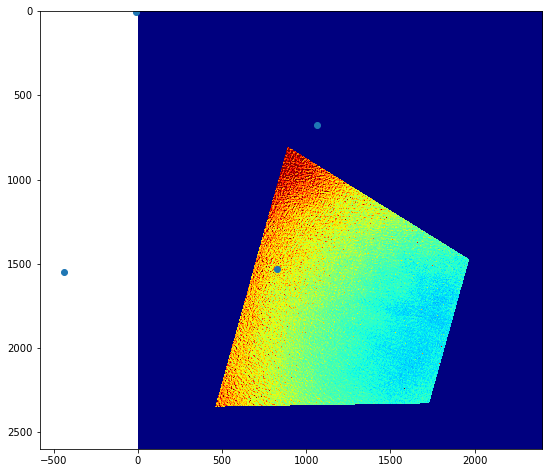

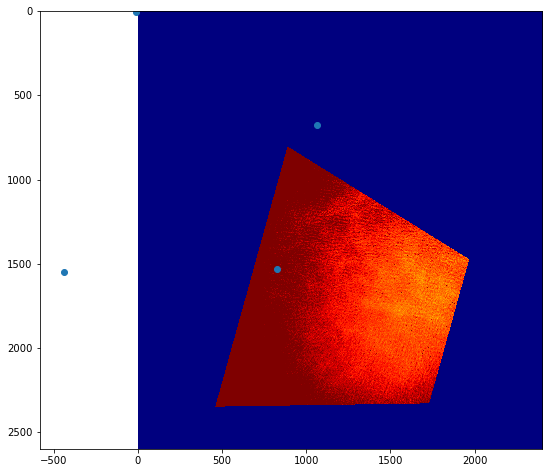

In [58]:
from skimage.transform import resize

for i in range(15):
    
    # form is [x_min, x_max, y_min, y_max]
    top_im_bounds=[-110,10,-30,100]
    x_center_offset = 10 - 110 / 0.05
    
    original_img = plt.imread(sea_img_metadata[i]['image_name'])
    resized_blue = resize(sea_imgs[i,0], (original_img.shape[0], original_img.shape[1]), anti_aliasing=True)
    resized_green = resize(sea_imgs[i,1], (original_img.shape[0], original_img.shape[1]), anti_aliasing=True)
    
    fig, ax = plt.subplots(1,2, figsize=(15,4))
    im = ax[0].imshow(resized_blue,cmap='jet', vmin=0.015, vmax=.05)
    fig.colorbar(im, ax=ax[0], fraction=0.046, pad=0.04)
    ax[0].set_xticks([])
    ax[0].set_yticks([])
    ax[0].set_title('blue')
    
    im = ax[1].imshow(resized_green,cmap='jet', vmin=0.035, vmax=.065)
    fig.colorbar(im, ax=ax[1], fraction=0.046, pad=0.04)
    ax[1].set_xticks([])
    ax[1].set_yticks([])
    ax[1].set_title('green')
    plt.show()
    new_name = 'blue_georeg_finer' + sea_img_metadata[i]['filename']
    alta_micasense_georef(sea_img_metadata[i]['image_name'], new_name, resized_blue, alta_logs, top_im_bounds=top_im_bounds, scaling=0.05)
    new_name = 'green_georeg_finer' + sea_img_metadata[i]['filename']
    alta_micasense_georef(sea_img_metadata[i]['image_name'], new_name, resized_green, alta_logs, top_im_bounds=top_im_bounds, scaling=0.05)
    
    break